In [1]:
import torch
import numpy as np
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import matplotlib.pyplot as plt
import time
import sys
import os 
from scipy.sparse import linalg
from pathlib import Path
import itertools
if torch.cuda.is_available():  
    device = "cuda" 
else:  
    device = "cpu" 

torch.set_default_dtype(torch.float64)
pi = torch.tensor(np.pi,dtype=torch.float64)
ZERO = torch.tensor([0.]).to(device)

class model(nn.Module):
    """ ReLU k shallow neural network
    Parameters: 
    input size: input dimension
    hidden_size1 : number of hidden layers 
    num_classes: output classes 
    k: degree of relu functions
    """
    def __init__(self, input_size, hidden_size1, num_classes,k = 1):
        super().__init__()
        self.fc1 = nn.Linear(input_size, hidden_size1)
        self.fc2 = nn.Linear(hidden_size1, num_classes,bias = False)
        self.k = k 
    def forward(self, x):
        u1 = self.fc2(F.relu(self.fc1(x))**self.k)
        return u1
    def evaluate_derivative(self, x, i):
        if self.k == 1:
            u1 = self.fc2(torch.heaviside(self.fc1(x),ZERO) * self.fc1.weight.t()[i-1:i,:] )
        else:
            u1 = self.fc2(self.k*F.relu(self.fc1(x))**(self.k-1) *self.fc1.weight.t()[i-1:i,:] )  
        return u1


def plot_2D(f,bl = [0,0], ur=[1,1]): 
    
    Nx = 400
    Ny = 400 
    xs = np.linspace(bl[0], ur[0], Nx)
    ys = np.linspace(bl[1], ur[1], Ny)
    x, y = np.meshgrid(xs, ys, indexing='xy')
    xy_comb = np.stack((x.flatten(),y.flatten())).T
    xy_comb = torch.tensor(xy_comb)
    z = f(xy_comb).reshape(Nx,Ny)
    z = z.detach().numpy()
    plt.figure(dpi=200)
    ax = plt.axes(projection='3d')
    ax.plot_surface(x , y , z )

    plt.show()


def plot_subdomains(my_model):
    x_coord =torch.linspace(0,1,200)
    wi = my_model.fc1.weight.data
    bi = my_model.fc1.bias.data 
    for i, bias in enumerate(bi):  
        if wi[i,1] !=0: 
            plt.plot(x_coord, - wi[i,0]/wi[i,1]*x_coord - bias/wi[i,1])
        else: 
            plt.plot(x_coord,  - bias/wi[i,0]*torch.ones(x_coord.size()))

    plt.xlim([0,1])
    plt.ylim([0,1])
    plt.legend()
    plt.show()
    return 0   

def adjust_neuron_position(my_model, dims = 3, choice = 1): 
    ##  choice 1:  [0,1]^d, choice 2: [-1,1]^d
    def create_mesh_grid(dims, pts):
        mesh = torch.tensor(list(itertools.product(pts,repeat=dims)))
        vertices = mesh.reshape(len(pts) ** dims, -1) 
        return vertices
    counter = 0 
    # positions = torch.tensor([[0.,0.],[0.,1.],[1.,1.],[1.,0.]])
    # pts = torch.tensor([0.,1.]) # for domain [0,1]^d 
    if choice == 1: 
        pts = torch.tensor([0.,1.])
    elif choice == 2:
        pts = torch.tensor([-1.,1.])# for domain [-1,1]^d 
    positions = create_mesh_grid(dims,pts) 
    neuron_num = my_model.fc1.bias.size(0)
    for i in range(neuron_num): 
        w = my_model.fc1.weight.data[i:i+1,:]
        b = my_model.fc1.bias.data[i]
    #     print(w,b)
        values = torch.matmul(positions,w.T) # + b
        left_end = - torch.max(values)
        right_end = - torch.min(values)
        offset = (right_end - left_end)/50
        if b <= left_end + offset/2 : 
            b = torch.rand(1)*(right_end - left_end - offset) + left_end + offset/2 
            my_model.fc1.bias.data[i] = b 
        if b >= right_end - offset/2 :
            if counter < (dims+1):
#                 print("here")
                counter += 1
            else: # (d + 1) or more 
                b = torch.rand(1)*(right_end - left_end - offset) + left_end + offset/2 
                my_model.fc1.bias.data[i] = b 
    return my_model




In [2]:
def show_convergence_order(err_l2,exponent,dict_size, filename,write2file = False):
    
    if write2file:
        file_mode = "a" if os.path.exists(filename) else "w"
        f_write = open(filename, file_mode)
    
    neuron_nums = [2**j for j in range(2,exponent+1)]
    err_list = [err_l2[i] for i in neuron_nums ]

    # f_write.write('M:{}, relu {} \n'.format(M,k))
    if write2file:
        f_write.write('dictionary size: {}\n'.format(dict_size))
        f_write.write("neuron num \t\t error \t\t order \t\t h10 error \\ order \n")
    print("neuron num \t\t error \t\t order")
    for i, item in enumerate(err_list):
        if i == 0: 
            # print(neuron_nums[i], end = "\t\t")
            # print(item, end = "\t\t")
            
            # print("*")
            print("{} \t\t {:.6f} \t\t * \t\t {:.6f} \t\t * \n".format(neuron_nums[i],item) )
            if write2file: 
                f_write.write("{} \t\t {} \t\t * \t\t {} \t\t * \n".format(neuron_nums[i],item ))
        else:
            # print(neuron_nums[i], end = "\t\t")
            # print(item, end = "\t\t") 
            # print(np.log(err_list[i-1]/err_list[i])/np.log(2))
            print("{} \t\t {:.6f} \t\t {:.6f} \t\t {:.6f} \t\t {:.6f} \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2) ) )
            if write2file: 
                f_write.write("{} \t\t {} \t\t {} \t\t {} \t\t {} \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2) ))
    if write2file:     
        f_write.write("\n")
        f_write.close()

def show_convergence_order_latex(err_l2,exponent): 
    neuron_nums = [2**j for j in range(2,exponent+1)]
    err_list = [err_l2[i] for i in neuron_nums ]
    print("neuron num  & \t $\|u-u_n \|_{L^2}$ & \t order & \t $ | u -u_n |_{H^1}$ & \t order \\\ \hline \hline ")
    for i, item in enumerate(err_list):
        if i == 0: 
            print("{} \t\t & {:.6f} &\t\t * & \t\t {:.6f} & \t\t *  \\\ \hline  \n".format(neuron_nums[i],item ) )   
        else: 
            print("{} \t\t &  {:.3e} &  \t\t {:.2f} &  \t\t {:.3e} &  \t\t {:.2f} \\\ \hline  \n".format(neuron_nums[i],item ) )


## quadrature rule  



In [3]:

def PiecewiseGQ2D_weights_points_general_square(Nx, order,bl = [-1,-1],ur = [1,1]): 
    """ A slight modification of PiecewiseGQ2D function that only needs the weights and integration points.
    Parameters
    Allows a symmetric square domain (around 0) with lower left corner at bl and upper right corner at ur 
    ----------

    Nx: int 
        number of intervals along the dimension. No Ny, assume Nx = Ny
    order: int 
        order of the Gauss Quadrature

    Returns
    -------
    long_weights: torch.tensor
    integration_points: torch.tensor
    """
#     print("order: ",order )
    x, w = np.polynomial.legendre.leggauss(order)
    gauss_pts = np.array(np.meshgrid(x,x,indexing='ij')).reshape(2,-1).T
    weights =  (w*w[:,None]).ravel()

    gauss_pts =torch.tensor(gauss_pts)
    weights = torch.tensor(weights)

    h = (ur[0]- bl[0])/Nx # 100 intervals 
    long_weights =  torch.tile(weights,(Nx**2,1))
    long_weights = long_weights.reshape(-1,1)
    long_weights = long_weights * h**2 /4 

    integration_points = torch.tile(gauss_pts,(Nx**2,1))
    scale_factor = h/2 
    integration_points = scale_factor * integration_points

    index = np.arange(0,Nx)  
    ordered_pairs = np.array(np.meshgrid(index,index,indexing='ij'))
    ordered_pairs = ordered_pairs.reshape(2,-1).T

    # print(ordered_pairs)
    # print()
    ordered_pairs = torch.tensor(ordered_pairs)
    # print(ordered_pairs.size())
    ordered_pairs = torch.tile(ordered_pairs, (1,order**2)) # number of GQ points
    # print(ordered_pairs)

    ordered_pairs =  ordered_pairs.reshape(-1,2)
    # print(ordered_pairs)
    translation = ordered_pairs*h + (torch.tensor(bl) + h/2) 
    # print(translation)

    integration_points = integration_points + translation 
#     print(integration_points.size())
    # func_values = integrand2_torch(integration_points)
    return long_weights, integration_points

def PiecewiseGQ2D_weights_points(Nx, order,bl = [0,0],ur = [1,1]): 
    """ A slight modification of PiecewiseGQ2D function that only needs the weights and integration points.
    Parameters
    Allows a symmetric square domain (around 0) with lower left corner at bl and upper right corner at ur 
    ----------

    Nx: int 
        number of intervals along the dimension. No Ny, assume Nx = Ny
    order: int 
        order of the Gauss Quadrature

    Returns
    -------
    long_weights: torch.tensor
    integration_points: torch.tensor
    """
#     print("order: ",order )
    x, w = np.polynomial.legendre.leggauss(order)
    gauss_pts = np.array(np.meshgrid(x,x,indexing='ij')).reshape(2,-1).T
    weights =  (w*w[:,None]).ravel()

    gauss_pts =torch.tensor(gauss_pts)
    weights = torch.tensor(weights)

    h = (ur[0]- bl[0])/Nx # 100 intervals 
    long_weights =  torch.tile(weights,(Nx**2,1))
    long_weights = long_weights.reshape(-1,1)
    long_weights = long_weights * h**2 /4 

    integration_points = torch.tile(gauss_pts,(Nx**2,1))
    scale_factor = h/2 
    integration_points = scale_factor * integration_points

    index = np.arange(0,Nx)  
    ordered_pairs = np.array(np.meshgrid(index,index,indexing='ij'))
    ordered_pairs = ordered_pairs.reshape(2,-1).T

    # print(ordered_pairs)
    # print()
    ordered_pairs = torch.tensor(ordered_pairs)
    # print(ordered_pairs.size())
    ordered_pairs = torch.tile(ordered_pairs, (1,order**2)) # number of GQ points
    # print(ordered_pairs)

    ordered_pairs =  ordered_pairs.reshape(-1,2)
    # print(ordered_pairs)
    translation = ordered_pairs*h + (torch.tensor(bl) + h/2) 
    # print(translation)

    integration_points = integration_points + translation 
#     print(integration_points.size())
    # func_values = integrand2_torch(integration_points)
    return long_weights, integration_points


In [4]:
def f(x):
    return torch.sin(4*pi*x[:,0])*torch.sin(2*pi*x[:,1]) 

def f(x):
    return x[:,0:1]**6 * x[:,1:2]**2  

integration_weights, integration_points = PiecewiseGQ2D_weights_points_general_square(12, 3,bl = [-1,-1],ur = [1,1])

integral = torch.sum(f(integration_points)*integration_weights) 

integral 

tensor(0.1905)

In [5]:
def minimize_linear_layer_explicit_assemble(model,target,weights, integration_points,solver="direct"):
    """
    calls the following functions (dependency): 
    1. GQ_piecewise_2D
    input: the nn model containing parameter 
    1. define the loss function  
    2. take derivative to extract the linear system A
    3. call the cg solver in scipy to solve the linear system 
    output: sol. solution of Ax = b
    """
    start_time = time.time() 
    w = model.fc1.weight.data 
    b = model.fc1.bias.data 
    basis_value_col = F.relu(integration_points @ w.t()+ b)**(model.k) 
    weighted_basis_value_col = basis_value_col * weights 
    jac = weighted_basis_value_col.t() @ basis_value_col 
     
    rhs = weighted_basis_value_col.t() @ (target(integration_points)) 
    print("assembling the matrix time taken: ", time.time()-start_time) 
    start_time = time.time()    
    if solver == "cg": 
        sol, exit_code = linalg.cg(np.array(jac.detach().cpu()),np.array(rhs.detach().cpu()),tol=1e-12)
        sol = torch.tensor(sol).view(1,-1)
    elif solver == "direct": 
#         sol = np.linalg.inv( np.array(jac.detach().cpu()) )@np.array(rhs.detach().cpu())
        sol = (torch.linalg.solve( jac.detach(), rhs.detach())).view(1,-1)
    elif solver == "ls":
        sol = (torch.linalg.lstsq(jac.detach().cpu(),rhs.detach().cpu(),driver='gelsd').solution).view(1,-1)
        # sol = (torch.linalg.lstsq(jac.detach(),rhs.detach()).solution).view(1,-1) # gpu/cpu, driver = 'gels', cannot solve singular
    print("solving Ax = b time taken: ", time.time()-start_time)
    return sol 


assembling the matrix time taken:  0.000522613525390625
solving Ax = b time taken:  0.001317739486694336


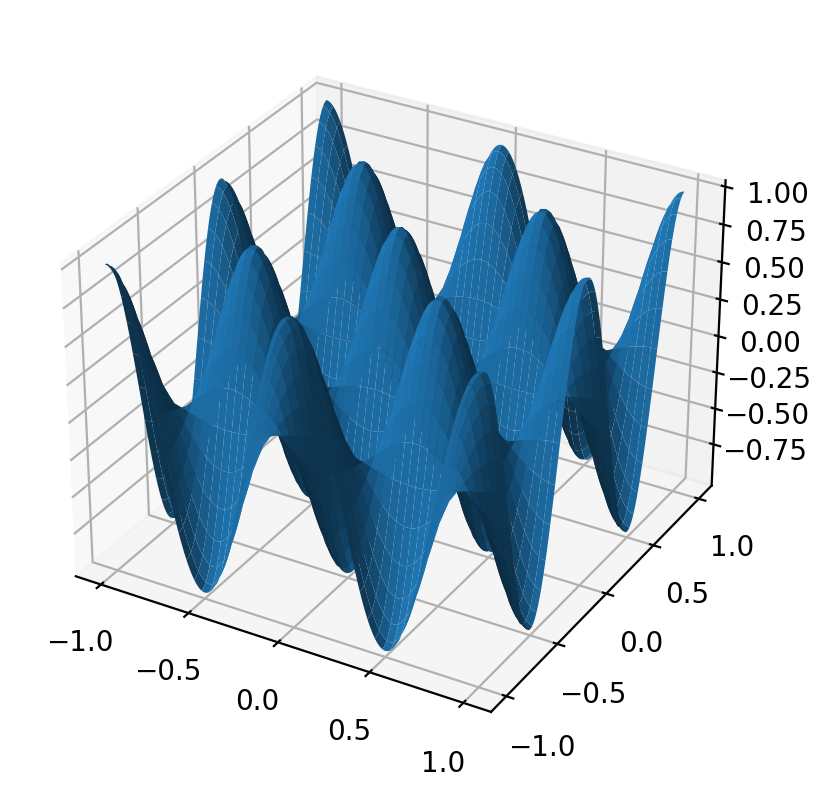

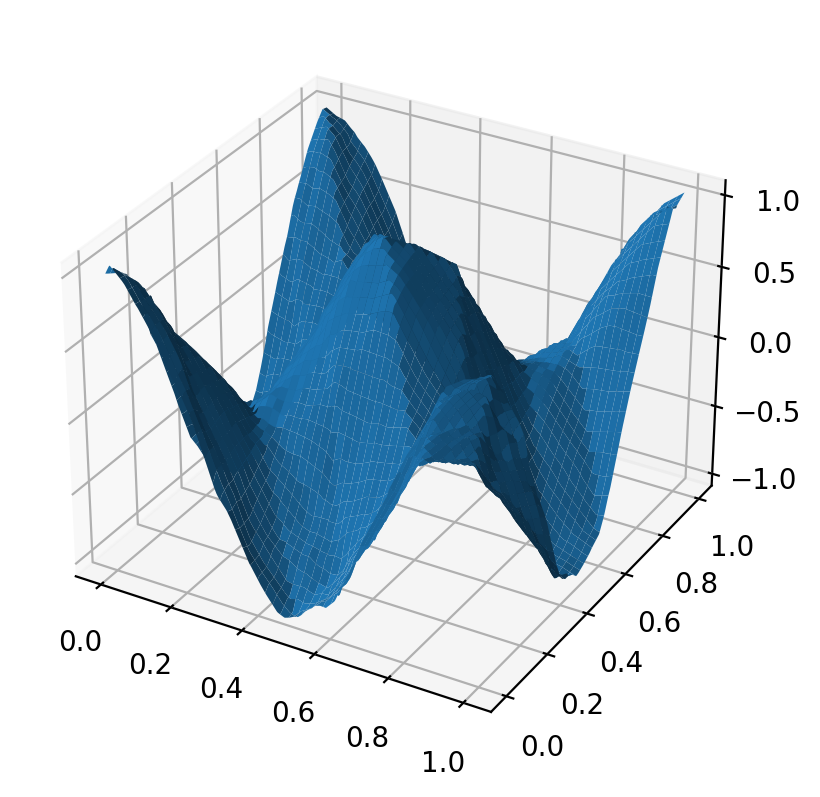

assembling the matrix time taken:  0.004126787185668945
solving Ax = b time taken:  0.007848978042602539


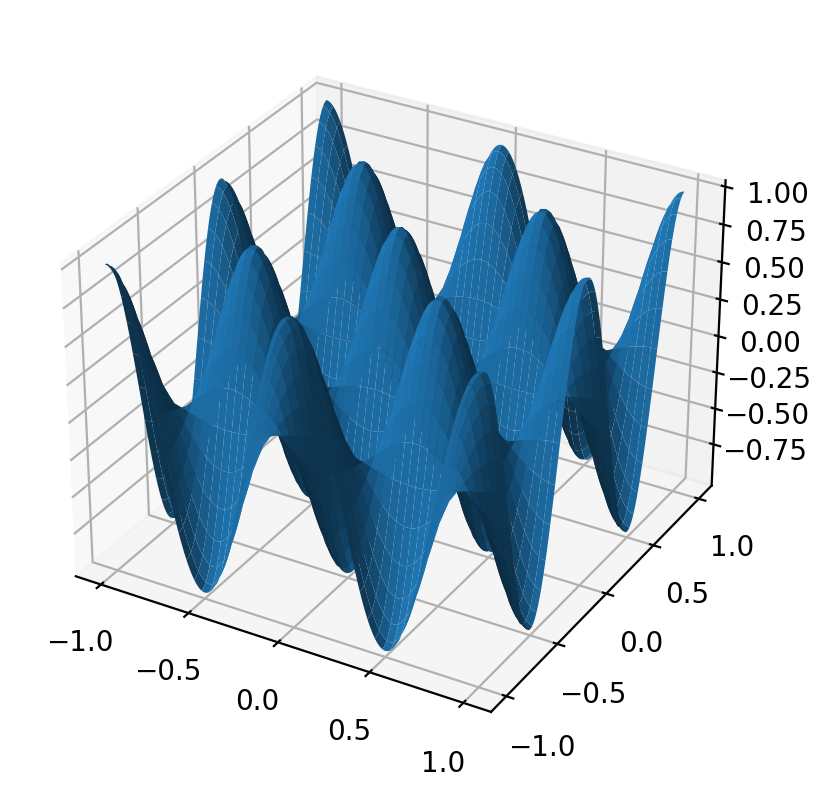

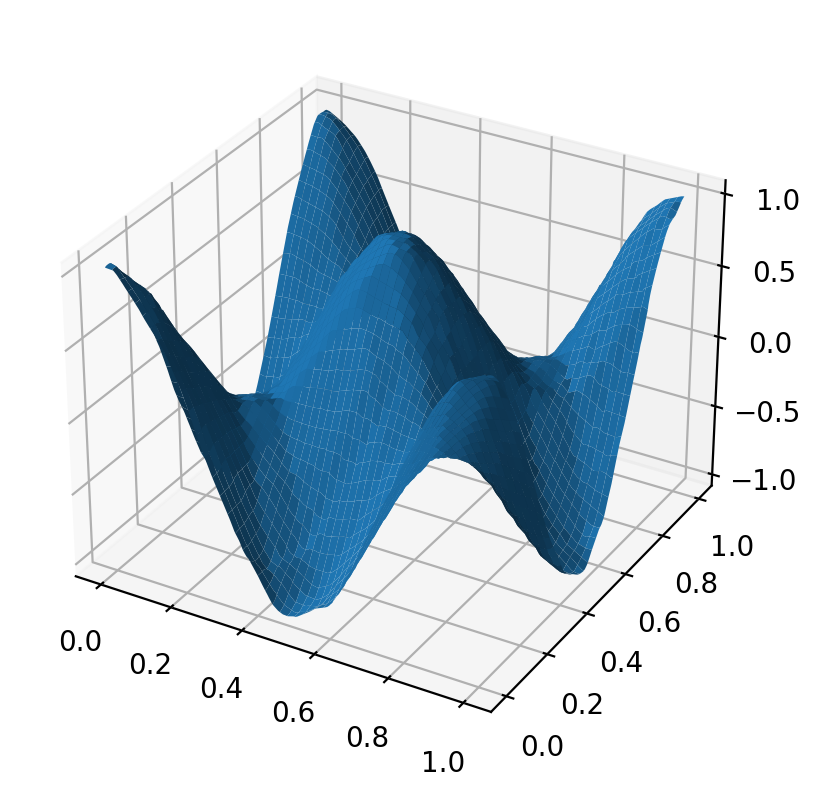

In [10]:
# def target(x):
#     sigma = 0.15# s.d of Gaussian 
#     frequency = 4  # frequency of cosine 
#     z=  torch.exp( - ( (x[:,0:1]-0.5)**2 + ( x[:,1:2] -0.5)**2)  / (2*sigma**2)) *  torch.cos(2 * pi * frequency * x[:,0:1])
#     return z 

def target(x):
    return torch.cos(2 * pi*x[:,0:1]) * torch.cos(2 * pi*x[:,1:2]) 

# integration_weights, integration_points = PiecewiseGQ2D_weights_points_general_square(50, 3,bl = [-1,-1],ur = [1,1])
integration_weights, integration_points = PiecewiseGQ2D_weights_points(50, 3)
integration_weights = integration_weights.to(device)
integration_points = integration_points.to(device)
neuron_nums = [160]
for neuron_num in neuron_nums: 
    my_model = model(2, neuron_num, 1, k = 1).to(device) 
    my_model = adjust_neuron_position(my_model.cpu(),dims=2,choice=1).to(device) 
    sol = minimize_linear_layer_explicit_assemble(my_model,target,integration_weights,integration_points,solver="direct") 
    my_model.fc2.weight.data[0,:] = sol[:]
    plot_2D(target,[-1,-1],[1,1])
    # plot_2D(my_model,[-1,-1],[1,1])  
    plot_2D(my_model.cpu())  


def target(x):
    return torch.cos(2 * pi*x[:,0:1]) * torch.cos(2 * pi*x[:,1:2]) 

integration_weights, integration_points = PiecewiseGQ2D_weights_points(50, 3,bl = [-1,-1],ur = [1,1])
integration_weights = integration_weights.to(device)
integration_points = integration_points.to(device)
neuron_nums = [640]
for neuron_num in neuron_nums: 
    my_model = model(2, neuron_num, 1, k = 1).to(device) 
    my_model = adjust_neuron_position(my_model.cpu(),dims=2,choice=2).to(device) 
    sol = minimize_linear_layer_explicit_assemble(my_model,target,integration_weights,integration_points,solver="direct") 
    my_model.fc2.weight.data[0,:] = sol[:]
    plot_2D(target,[-1,-1],[1,1])
    # plot_2D(my_model,[-1,-1],[1,1])  
    plot_2D(my_model.cpu())  


In [11]:
def OGAL2FittingReLU2D(my_model,target,N_list,num_epochs,plot_freq, Nx, order, k =1, linear_solver = "direct",Domain = [[0,0],[1,1]]): 
    """ Orthogonal greedy algorithm using 1D ReLU dictionary over [-pi,pi]
    Parameters
    ----------
    my_model: 
        nn model 
    target: 
        target function
    num_epochs: int 
        number of training epochs 
    integration_intervals: int 
        number of subintervals for piecewise numerical quadrature 

    Returns
    -------
    err: tensor 
        rank 1 torch tensor to record the L2 error history  
    model: 
        trained nn model 
    """
    #Todo Done
    gw_expand, integration_points = PiecewiseGQ2D_weights_points(Nx, order,Domain[0],Domain[1])
    gw_expand = gw_expand.to(device)
    integration_points = integration_points.to(device)

    err = torch.zeros(num_epochs+1)
    if my_model == None: 
        func_values = target(integration_points)
        num_neuron = 0

        list_b = []
        list_w = []
    else: 
        func_values = target(integration_points) - my_model(integration_points).detach()
        bias = my_model.fc1.bias.detach().data
        weights = my_model.fc1.weight.detach().data
        num_neuron = int(bias.size(0))

        list_b = list(bias)
        list_w = list(weights)
    
    # initial error Todo Done
    func_values_sqrd = func_values*func_values
    # print(func_values_sqrd.size())
    # print(gw_expand.size()) 
    err[0]= torch.sum(func_values_sqrd*gw_expand)**0.5
    start_time = time.time()
    solver = linear_solver
    relu_dict_parameters = generate_relu_dict2D(N_list).to(device)
    print("using linear solver: ",solver)
    for i in range(num_epochs): 
        print("epoch: ",i+1, end = '\t')
        if num_neuron == 0: 
            func_values = target(integration_points)
        else: 
            func_values = target(integration_points) - my_model(integration_points).detach()

        weight_func_values = func_values*gw_expand  
        basis_values = (F.relu( torch.matmul(integration_points,relu_dict_parameters[:,0:2].T ) - relu_dict_parameters[:,2])**k).T # uses broadcasting

        output = torch.abs(torch.matmul(basis_values,weight_func_values)) # 
        neuron_index = torch.argmax(output.flatten())
        
        # print(neuron_index)
        list_w.append(relu_dict_parameters[neuron_index,0:2]) # 
        list_b.append(-relu_dict_parameters[neuron_index,2])
        num_neuron += 1
        my_model = model(2,num_neuron,1,k).to(device)
        w_tensor = torch.stack(list_w, 0 ) 
        b_tensor = torch.tensor(list_b)
        my_model.fc1.weight.data[:,:] = w_tensor[:,:]
        my_model.fc1.bias.data[:] = b_tensor[:]

        #Todo Done 
#         sol = minimize_linear_layer(my_model,target,solver,Nx,order)
        sol = minimize_linear_layer_explicit_assemble(my_model,target,gw_expand, integration_points, solver)

        my_model.fc2.weight.data[0,:] = sol[:]
        if (i+1)%plot_freq == 0: 
            plot_2D(my_model.cpu())
            my_model = my_model.to(device)

        func_values = target(integration_points) - my_model(integration_points).detach()
        func_values_sqrd = func_values*func_values

        #Todo Done 
        err[i+1]= torch.sum(func_values_sqrd*gw_expand)**0.5
    print("time taken: ",time.time() - start_time)
    return err, my_model


def generate_relu_dict2D(N_list):
    N1 = N_list[0] 
    N2 = N_list[1]
    
    theta = np.linspace(0, 2*pi, N1, endpoint= False).reshape(N1,1)
    W1 = np.cos(theta)
    W2 = np.sin(theta)
    W = np.concatenate((W1,W2),1) # N1 x 2
    b = np.linspace(-1.42, 1.42, N2,endpoint=False).reshape(N2,1)
    
    index1 = np.arange(N1)
    index2 = np.arange(N2)
    ordered_pairs = np.array(np.meshgrid(index1,index2,indexing='ij'))

    ordered_pairs = ordered_pairs.reshape(2,-1).T
    W = W[ordered_pairs[:,0],:]
    b = b[ordered_pairs[:,1],:]
    Wb = np.concatenate((W,b),1) # N1 x 3 
    Wb_tensor = torch.from_numpy(Wb) 
    return Wb_tensor

N_list = [10,20]
Wb = generate_relu_dict2D(N_list).to(device)
print(Wb.shape)


# def generate_relu_dict2D_QMC(s,N0):
#     # add this method to your notes... otherwise you will forget it 
#     # Generate randomized Sobol sequence 
    
# #     Sob = torch.quasirandom.SobolEngine(dimension =2, scramble= True, seed=None) 
# #     samples = Sob.draw(N0).double()

# #     for i in range(s-1):
# #         samples = torch.cat([samples,Sob.draw(N0).double()],0)

#     samples = torch.rand(s*N0,2) 
    
#     T =torch.tensor([[2*pi,0],[0,2.84]])

#     shift = torch.tensor([0,-1.42]) 

#     samples = samples@T + shift 

#     theta = samples[:,0].reshape(s*N0,1)
#     W1 = torch.cos(theta)
#     W2 = torch.sin(theta)
#     W = torch.cat((W1,W2),1) # N1 x 2
#     # b = np.linspace(-1.42, 1.42, N2,endpoint=False).reshape(N2,1) 
#     b = samples[:,1].reshape(s*N0,1)
    
#     Wb = torch.cat((W,b),1) # N1 x 3 

#     return Wb 

def generate_relu_dict2D_QMC_new(s,N0):
    # add this method to your notes... otherwise you will forget it 
    samples = torch.randn(s*N0,3) 
    
    samples = samples/samples.norm(dim=1,keepdim=True)  
    
    Wb = samples 

    return Wb 

def OGAL2FittingReLU2D_QMC(my_model,target,s,N0,num_epochs,plot_freq, Nx, order, k =1, linear_solver = "direct",Domain = [[0,0],[1,1]]): 
    """ Orthogonal greedy algorithm using 1D ReLU dictionary over [-pi,pi]
    Parameters
    ----------
    my_model: 
        nn model 
    target: 
        target function
    num_epochs: int 
        number of training epochs 
    integration_intervals: int 
        number of subintervals for piecewise numerical quadrature 

    Returns
    -------
    err: tensor 
        rank 1 torch tensor to record the L2 error history  
    model: 
        trained nn model 
    """
    #Todo Done
    gw_expand, integration_points = PiecewiseGQ2D_weights_points(Nx, order,Domain[0],Domain[1])
    gw_expand = gw_expand.to(device)
    integration_points = integration_points.to(device)

    err = torch.zeros(num_epochs+1)
    if my_model == None: 
        func_values = target(integration_points)
        num_neuron = 0

        list_b = []
        list_w = []
    else: 
        func_values = target(integration_points) - my_model(integration_points).detach()
        bias = my_model.fc1.bias.detach().data
        weights = my_model.fc1.weight.detach().data
        num_neuron = int(bias.size(0))

        list_b = list(bias)
        list_w = list(weights)
    
    # initial error Todo Done
    func_values_sqrd = func_values*func_values
    err[0]= torch.sum(func_values_sqrd*gw_expand)**0.5
    start_time = time.time()
    
    solver = linear_solver
    print("using linear solver: ",solver)
    for i in range(num_epochs): 
        relu_dict_parameters = generate_relu_dict2D_QMC_new(s,N0).to(device) 
        print("epoch: ",i+1, end = '\t')
        if num_neuron == 0: 
            func_values = target(integration_points)
        else: 
            func_values = target(integration_points) - my_model(integration_points).detach()

        weight_func_values = func_values*gw_expand  
        basis_values = (F.relu( torch.matmul(integration_points,relu_dict_parameters[:,0:2].T ) - relu_dict_parameters[:,2])**k).T # uses broadcasting

        output = torch.abs(torch.matmul(basis_values,weight_func_values)) # 
        neuron_index = torch.argmax(output.flatten())
        
        # print(neuron_index)
        list_w.append(relu_dict_parameters[neuron_index,0:2]) # 
        list_b.append(-relu_dict_parameters[neuron_index,2])
        num_neuron += 1
        my_model = model(2,num_neuron,1,k).to(device)
        w_tensor = torch.stack(list_w, 0 ) 
        b_tensor = torch.tensor(list_b)
        my_model.fc1.weight.data[:,:] = w_tensor[:,:]
        my_model.fc1.bias.data[:] = b_tensor[:]

        #Todo 
#         sol = minimize_linear_layer(my_model,target,solver,Nx,order)
        sol = minimize_linear_layer_explicit_assemble(my_model,target,gw_expand, integration_points, solver)

        my_model.fc2.weight.data[0,:] = sol[:]
        if (i+1)%plot_freq == 0: 
            plot_2D(my_model.cpu(),Domain[0],Domain[1])
            my_model = my_model.to(device)

        func_values = target(integration_points) - my_model(integration_points).detach()
        func_values_sqrd = func_values*func_values

        #Todo Done 
        err[i+1]= torch.sum(func_values_sqrd*gw_expand)**0.5
    print("time taken: ",time.time() - start_time)
    return err, my_model


torch.Size([200, 3])


## Greedy algorithm 

using linear solver:  direct
epoch:  1	assembling the matrix time taken:  0.0005822181701660156
solving Ax = b time taken:  0.12961554527282715
epoch:  2	assembling the matrix time taken:  0.0003352165222167969
solving Ax = b time taken:  0.00016927719116210938
epoch:  3	assembling the matrix time taken:  0.00019669532775878906
solving Ax = b time taken:  0.00013136863708496094
epoch:  4	assembling the matrix time taken:  0.00018739700317382812
solving Ax = b time taken:  0.0001266002655029297
epoch:  5	assembling the matrix time taken:  0.00045561790466308594
solving Ax = b time taken:  0.00012373924255371094
epoch:  6	assembling the matrix time taken:  0.00018858909606933594
solving Ax = b time taken:  0.0001220703125
epoch:  7	assembling the matrix time taken:  0.0001842975616455078
solving Ax = b time taken:  0.00012087821960449219
epoch:  8	assembling the matrix time taken:  0.000186920166015625
solving Ax = b time taken:  0.00021219253540039062
epoch:  9	assembling the matrix tim

epoch:  75	assembling the matrix time taken:  0.0002465248107910156
solving Ax = b time taken:  0.0004794597625732422
epoch:  76	assembling the matrix time taken:  0.0002567768096923828
solving Ax = b time taken:  0.00048661231994628906
epoch:  77	assembling the matrix time taken:  0.00022864341735839844
solving Ax = b time taken:  0.000530242919921875
epoch:  78	assembling the matrix time taken:  0.0002446174621582031
solving Ax = b time taken:  0.0005121231079101562
epoch:  79	assembling the matrix time taken:  0.00022411346435546875
solving Ax = b time taken:  0.0005545616149902344
epoch:  80	assembling the matrix time taken:  0.00024366378784179688
solving Ax = b time taken:  0.0005233287811279297
epoch:  81	assembling the matrix time taken:  0.00023865699768066406
solving Ax = b time taken:  0.000553131103515625
epoch:  82	assembling the matrix time taken:  0.0002372264862060547
solving Ax = b time taken:  0.0005588531494140625
epoch:  83	assembling the matrix time taken:  0.00022

epoch:  150	assembling the matrix time taken:  0.0002868175506591797
solving Ax = b time taken:  0.0012907981872558594
epoch:  151	assembling the matrix time taken:  0.00028395652770996094
solving Ax = b time taken:  0.0013320446014404297
epoch:  152	assembling the matrix time taken:  0.0002579689025878906
solving Ax = b time taken:  0.0013206005096435547
epoch:  153	assembling the matrix time taken:  0.00029349327087402344
solving Ax = b time taken:  0.0013315677642822266
epoch:  154	assembling the matrix time taken:  0.00028967857360839844
solving Ax = b time taken:  0.0013263225555419922
epoch:  155	assembling the matrix time taken:  0.00029659271240234375
solving Ax = b time taken:  0.0013370513916015625
epoch:  156	assembling the matrix time taken:  0.0002753734588623047
solving Ax = b time taken:  0.0013408660888671875
epoch:  157	assembling the matrix time taken:  0.0002586841583251953
solving Ax = b time taken:  0.0013871192932128906
epoch:  158	assembling the matrix time taken

epoch:  230	assembling the matrix time taken:  0.00025582313537597656
solving Ax = b time taken:  0.001852273941040039
epoch:  231	assembling the matrix time taken:  0.0002560615539550781
solving Ax = b time taken:  0.0018854141235351562
epoch:  232	assembling the matrix time taken:  0.00027489662170410156
solving Ax = b time taken:  0.0018455982208251953
epoch:  233	assembling the matrix time taken:  0.0002799034118652344
solving Ax = b time taken:  0.0018858909606933594
epoch:  234	assembling the matrix time taken:  0.00025534629821777344
solving Ax = b time taken:  0.0019054412841796875
epoch:  235	assembling the matrix time taken:  0.0002541542053222656
solving Ax = b time taken:  0.0019152164459228516
epoch:  236	assembling the matrix time taken:  0.0002548694610595703
solving Ax = b time taken:  0.0018944740295410156
epoch:  237	assembling the matrix time taken:  0.0002639293670654297
solving Ax = b time taken:  0.0019154548645019531
epoch:  238	assembling the matrix time taken: 

epoch:  303	assembling the matrix time taken:  0.00025653839111328125
solving Ax = b time taken:  0.0028543472290039062
epoch:  304	assembling the matrix time taken:  0.0002865791320800781
solving Ax = b time taken:  0.002789020538330078
epoch:  305	assembling the matrix time taken:  0.0002579689025878906
solving Ax = b time taken:  0.0028831958770751953
epoch:  306	assembling the matrix time taken:  0.0002779960632324219
solving Ax = b time taken:  0.0028531551361083984
epoch:  307	assembling the matrix time taken:  0.00025844573974609375
solving Ax = b time taken:  0.0028994083404541016
epoch:  308	assembling the matrix time taken:  0.0002560615539550781
solving Ax = b time taken:  0.002872943878173828
epoch:  309	assembling the matrix time taken:  0.0002582073211669922
solving Ax = b time taken:  0.0029120445251464844
epoch:  310	assembling the matrix time taken:  0.00025725364685058594
solving Ax = b time taken:  0.002903461456298828
epoch:  311	assembling the matrix time taken:  0

epoch:  379	assembling the matrix time taken:  0.0002574920654296875
solving Ax = b time taken:  0.0036916732788085938
epoch:  380	assembling the matrix time taken:  0.00025463104248046875
solving Ax = b time taken:  0.003693819046020508
epoch:  381	assembling the matrix time taken:  0.0002551078796386719
solving Ax = b time taken:  0.0037343502044677734
epoch:  382	assembling the matrix time taken:  0.00026416778564453125
solving Ax = b time taken:  0.0037183761596679688
epoch:  383	assembling the matrix time taken:  0.0002639293670654297
solving Ax = b time taken:  0.003707408905029297
epoch:  384	assembling the matrix time taken:  0.0002522468566894531
solving Ax = b time taken:  0.0037076473236083984
epoch:  385	assembling the matrix time taken:  0.00026917457580566406
solving Ax = b time taken:  0.00418853759765625
epoch:  386	assembling the matrix time taken:  0.00026702880859375
solving Ax = b time taken:  0.004193305969238281
epoch:  387	assembling the matrix time taken:  0.000

epoch:  449	assembling the matrix time taken:  0.0002694129943847656
solving Ax = b time taken:  0.004822969436645508
epoch:  450	assembling the matrix time taken:  0.0002574920654296875
solving Ax = b time taken:  0.004827260971069336
epoch:  451	assembling the matrix time taken:  0.0002551078796386719
solving Ax = b time taken:  0.004842281341552734
epoch:  452	assembling the matrix time taken:  0.00025582313537597656
solving Ax = b time taken:  0.00482487678527832
epoch:  453	assembling the matrix time taken:  0.0002598762512207031
solving Ax = b time taken:  0.0048716068267822266
epoch:  454	assembling the matrix time taken:  0.0002560615539550781
solving Ax = b time taken:  0.004868507385253906
epoch:  455	assembling the matrix time taken:  0.0002567768096923828
solving Ax = b time taken:  0.0048449039459228516
epoch:  456	assembling the matrix time taken:  0.00025582313537597656
solving Ax = b time taken:  0.004818439483642578
epoch:  457	assembling the matrix time taken:  0.0002

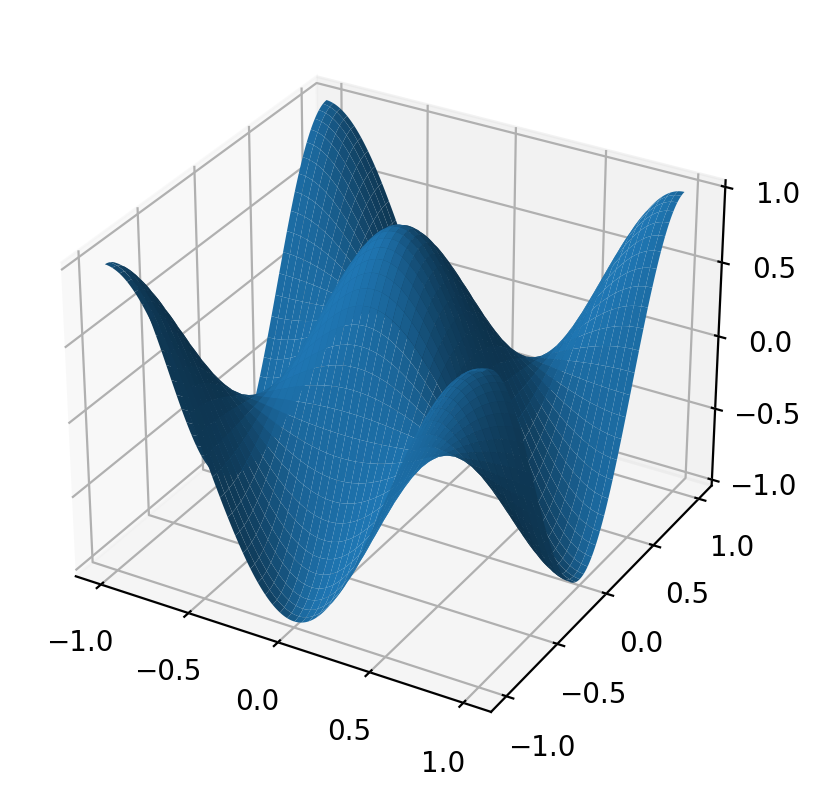

time taken:  9.958250045776367
neuron num 		 error 		 order
4 		 0.935756 		 * 		 

8 		 0.638961 		 0.550404 		 

16 		 0.122628 		 2.381436 		 

32 		 0.045905 		 1.417582 		 

64 		 0.011103 		 2.047676 		 

128 		 0.002647 		 2.068760 		 

256 		 0.000765 		 1.789988 		 

512 		 0.000194 		 1.976432 		 

neuron num  & 	 $\|u-u_n \|_{L^2}$ & 	 order \\ \hline \hline 
4 		 & 0.935756 &		 *  \\ \hline  

8 		 &  6.390e-01 &  		 0.55 \\ \hline  

16 		 &  1.226e-01 &  		 2.38 \\ \hline  

32 		 &  4.590e-02 &  		 1.42 \\ \hline  

64 		 &  1.110e-02 &  		 2.05 \\ \hline  

128 		 &  2.647e-03 &  		 2.07 \\ \hline  

256 		 &  7.653e-04 &  		 1.79 \\ \hline  

512 		 &  1.945e-04 &  		 1.98 \\ \hline  



In [7]:
def show_convergence_order(err_l2,exponent,dict_size, filename,write2file = False):
    
    if write2file:
        file_mode = "a" if os.path.exists(filename) else "w"
        f_write = open(filename, file_mode)
    
    neuron_nums = [2**j for j in range(2,exponent+1)]
    err_list = [err_l2[i] for i in neuron_nums ]

    # f_write.write('M:{}, relu {} \n'.format(M,k))
    if write2file:
        f_write.write('dictionary size: {}\n'.format(dict_size))
        f_write.write("neuron num \t\t error \t\t order \t\t h10 error \\ order \n")
    print("neuron num \t\t error \t\t order")
    for i, item in enumerate(err_list):
        if i == 0: 
            # print(neuron_nums[i], end = "\t\t")
            # print(item, end = "\t\t")
            
            # print("*")
            print("{} \t\t {:.6f} \t\t * \t\t \n".format(neuron_nums[i],item) )
            if write2file: 
                f_write.write("{} \t\t {} \t\t * \t\t \n".format(neuron_nums[i],item ))
        else:
            # print(neuron_nums[i], end = "\t\t")
            # print(item, end = "\t\t") 
            # print(np.log(err_list[i-1]/err_list[i])/np.log(2))
            print("{} \t\t {:.6f} \t\t {:.6f} \t\t \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2) ) )
            if write2file: 
                f_write.write("{} \t\t {} \t\t {}  \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2) ))
    if write2file:     
        f_write.write("\n")
        f_write.close()

def show_convergence_order_latex(err_l2,exponent): 
    neuron_nums = [2**j for j in range(2,exponent+1)]
    err_list = [err_l2[i] for i in neuron_nums ]
    print("neuron num  & \t $\|u-u_n \|_{L^2}$ & \t order \\\ \hline \hline ")
    for i, item in enumerate(err_list):
        if i == 0: 
            print("{} \t\t & {:.6f} &\t\t *  \\\ \hline  \n".format(neuron_nums[i],item, np.log(err_list[i-1]/err_list[i])/np.log(2) ) )   
        else: 
            print("{} \t\t &  {:.3e} &  \t\t {:.2f} \\\ \hline  \n".format(neuron_nums[i],item, np.log(err_list[i-1]/err_list[i])/np.log(2) ) )

# def target(x):
#     sigma = 0.15# s.d of Gaussian 
#     frequency = 4  # frequency of cosine 
#     z=  torch.exp( - ( (x[:,0:1]-0.5)**2 + ( x[:,1:2] -0.5)**2)  / (2*sigma**2)) *  torch.cos(2 * pi * frequency * x[:,0:1])
#     return z 

def target(x):
    z=  torch.cos(pi * x[:,0:1]) * torch.cos(pi * x[:,1:2]) 
    return z 


# function_name = "gabor2d" 
function_name = "coscos2d" 
filename_write = "data/2DQMCOGA-{}-order.txt".format(function_name)
f_write = open(filename_write, "a")
f_write.write("\n")
f_write.close() 

for N0 in [2**12]: 
    save = False
    f_write = open(filename_write, "a")
    my_model = None 
    s = 2**0
    Nx = 50 
    order = 3    
    exponent = 9  
    num_epochs = 2**exponent  
    plot_freq = num_epochs
    relu_k = 2 
    Domain = [[-1,-1],[1,1]] 
    err_QMC2, my_model = OGAL2FittingReLU2D_QMC(my_model,target,s,N0,num_epochs,plot_freq, Nx, order, k =relu_k, linear_solver = "direct",Domain = Domain)
    
    if save: 
        folder = 'data/'
        filename = folder + 'err_OGA_2D_{}_neuron_{}_N_{}_randomized.pt'.format(function_name,num_epochs,s*N0)
        torch.save(err_QMC2,filename) 
        folder = 'data/'
        filename = folder + 'model_OGA_2D_{}_neuron_{}_N_{}_randomized.pt'.format(function_name,num_epochs,s*N0)
        torch.save(my_model,filename)

    # neuron_nums = [2**j for j in range(2,exponent+1)]
    # err_list = [err_QMC2[i] for i in neuron_nums ]
    dict_size = s*N0 
    show_convergence_order(err_QMC2,exponent,dict_size, filename_write,write2file = True)
    show_convergence_order_latex(err_QMC2,exponent) 
    # f_write.write('dictionary size: {}\n'.format(s*N0))
    # f_write.write("neuron num \t\t error \t\t order\n")
    # print("neuron num \t\t error \t\t order")
    # for i, item in enumerate(err_list):
    #     if i == 0: 
    #         print(neuron_nums[i], end = "\t\t")
    #         print(item, end = "\t\t")
    #         print("*")
    #         f_write.write("{} \t\t {} \t\t * \n".format(neuron_nums[i],item))
    #     else: 
    #         print(neuron_nums[i], end = "\t\t")
    #         print(item, end = "\t\t") 
    #         print(np.log(err_list[i-1]/err_list[i])/np.log(2))
    #         f_write.write("{} \t\t {} \t\t {} \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2)))
    # f_write.write("\n")
    # f_write.close()


### non-smooth example 

using linear solver:  direct
epoch:  1	assembling the matrix time taken:  0.0037894248962402344
solving Ax = b time taken:  0.004315853118896484
epoch:  2	assembling the matrix time taken:  0.00027441978454589844
solving Ax = b time taken:  0.00014519691467285156
epoch:  3	assembling the matrix time taken:  0.00019097328186035156
solving Ax = b time taken:  0.0001277923583984375
epoch:  4	assembling the matrix time taken:  0.00018548965454101562
solving Ax = b time taken:  0.00012755393981933594
epoch:  5	assembling the matrix time taken:  0.00019025802612304688
solving Ax = b time taken:  0.0001361370086669922
epoch:  6	assembling the matrix time taken:  0.0001850128173828125
solving Ax = b time taken:  0.00012612342834472656
epoch:  7	assembling the matrix time taken:  0.000186920166015625
solving Ax = b time taken:  0.0001239776611328125
epoch:  8	assembling the matrix time taken:  0.000217437744140625
solving Ax = b time taken:  0.00014662742614746094
epoch:  9	assembling the matri

epoch:  71	assembling the matrix time taken:  0.00031447410583496094
solving Ax = b time taken:  0.0003972053527832031
epoch:  72	assembling the matrix time taken:  0.00029277801513671875
solving Ax = b time taken:  0.0004191398620605469
epoch:  73	assembling the matrix time taken:  0.00031948089599609375
solving Ax = b time taken:  0.00042557716369628906
epoch:  74	assembling the matrix time taken:  0.0002770423889160156
solving Ax = b time taken:  0.0004634857177734375
epoch:  75	assembling the matrix time taken:  0.0003006458282470703
solving Ax = b time taken:  0.0004563331604003906
epoch:  76	assembling the matrix time taken:  0.00030159950256347656
solving Ax = b time taken:  0.0004544258117675781
epoch:  77	assembling the matrix time taken:  0.0002853870391845703
solving Ax = b time taken:  0.0004730224609375
epoch:  78	assembling the matrix time taken:  0.0002758502960205078
solving Ax = b time taken:  0.00048542022705078125
epoch:  79	assembling the matrix time taken:  0.00027

solving Ax = b time taken:  0.0014345645904541016
epoch:  164	assembling the matrix time taken:  0.0003256797790527344
solving Ax = b time taken:  0.0013873577117919922
epoch:  165	assembling the matrix time taken:  0.00025391578674316406
solving Ax = b time taken:  0.0014681816101074219
epoch:  166	assembling the matrix time taken:  0.0002777576446533203
solving Ax = b time taken:  0.0014407634735107422
epoch:  167	assembling the matrix time taken:  0.00028443336486816406
solving Ax = b time taken:  0.0014612674713134766
epoch:  168	assembling the matrix time taken:  0.0003345012664794922
solving Ax = b time taken:  0.0013813972473144531
epoch:  169	assembling the matrix time taken:  0.0002734661102294922
solving Ax = b time taken:  0.0012996196746826172
epoch:  170	assembling the matrix time taken:  0.00026988983154296875
solving Ax = b time taken:  0.0013034343719482422
epoch:  171	assembling the matrix time taken:  0.0002841949462890625
solving Ax = b time taken:  0.001299142837524

solving Ax = b time taken:  0.001880645751953125
epoch:  235	assembling the matrix time taken:  0.0002694129943847656
solving Ax = b time taken:  0.001903533935546875
epoch:  236	assembling the matrix time taken:  0.00029850006103515625
solving Ax = b time taken:  0.0018579959869384766
epoch:  237	assembling the matrix time taken:  0.0002765655517578125
solving Ax = b time taken:  0.0019083023071289062
epoch:  238	assembling the matrix time taken:  0.00025272369384765625
solving Ax = b time taken:  0.001926422119140625
epoch:  239	assembling the matrix time taken:  0.0003235340118408203
solving Ax = b time taken:  0.0018725395202636719
epoch:  240	assembling the matrix time taken:  0.0002739429473876953
solving Ax = b time taken:  0.0018930435180664062
epoch:  241	assembling the matrix time taken:  0.0002732276916503906
solving Ax = b time taken:  0.001939535140991211
epoch:  242	assembling the matrix time taken:  0.00028204917907714844
solving Ax = b time taken:  0.0019350051879882812

epoch:  313	assembling the matrix time taken:  0.0003008842468261719
solving Ax = b time taken:  0.0028934478759765625
epoch:  314	assembling the matrix time taken:  0.0002944469451904297
solving Ax = b time taken:  0.002866506576538086
epoch:  315	assembling the matrix time taken:  0.0002841949462890625
solving Ax = b time taken:  0.0029022693634033203
epoch:  316	assembling the matrix time taken:  0.0002617835998535156
solving Ax = b time taken:  0.0029053688049316406
epoch:  317	assembling the matrix time taken:  0.00029730796813964844
solving Ax = b time taken:  0.0029077529907226562
epoch:  318	assembling the matrix time taken:  0.00027561187744140625
solving Ax = b time taken:  0.002925395965576172
epoch:  319	assembling the matrix time taken:  0.0002815723419189453
solving Ax = b time taken:  0.0029163360595703125
epoch:  320	assembling the matrix time taken:  0.00028586387634277344
solving Ax = b time taken:  0.0028998851776123047
epoch:  321	assembling the matrix time taken:  

solving Ax = b time taken:  0.004174709320068359
epoch:  395	assembling the matrix time taken:  0.0003788471221923828
solving Ax = b time taken:  0.0041277408599853516
epoch:  396	assembling the matrix time taken:  0.0002899169921875
solving Ax = b time taken:  0.004169940948486328
epoch:  397	assembling the matrix time taken:  0.00036025047302246094
solving Ax = b time taken:  0.004189729690551758
epoch:  398	assembling the matrix time taken:  0.0003769397735595703
solving Ax = b time taken:  0.0041463375091552734
epoch:  399	assembling the matrix time taken:  0.0003204345703125
solving Ax = b time taken:  0.004208803176879883
epoch:  400	assembling the matrix time taken:  0.0003666877746582031
solving Ax = b time taken:  0.004138946533203125
epoch:  401	assembling the matrix time taken:  0.00036525726318359375
solving Ax = b time taken:  0.004221916198730469
epoch:  402	assembling the matrix time taken:  0.0003769397735595703
solving Ax = b time taken:  0.004214763641357422
epoch:  4

epoch:  465	assembling the matrix time taken:  0.0002884864807128906
solving Ax = b time taken:  0.004904508590698242
epoch:  466	assembling the matrix time taken:  0.0002512931823730469
solving Ax = b time taken:  0.0049591064453125
epoch:  467	assembling the matrix time taken:  0.00034880638122558594
solving Ax = b time taken:  0.004876375198364258
epoch:  468	assembling the matrix time taken:  0.00036144256591796875
solving Ax = b time taken:  0.004861116409301758
epoch:  469	assembling the matrix time taken:  0.0003917217254638672
solving Ax = b time taken:  0.0048754215240478516
epoch:  470	assembling the matrix time taken:  0.0003571510314941406
solving Ax = b time taken:  0.004900455474853516
epoch:  471	assembling the matrix time taken:  0.0003783702850341797
solving Ax = b time taken:  0.004895687103271484
epoch:  472	assembling the matrix time taken:  0.0003757476806640625
solving Ax = b time taken:  0.00484013557434082
epoch:  473	assembling the matrix time taken:  0.0003623

epoch:  539	assembling the matrix time taken:  0.00028443336486816406
solving Ax = b time taken:  0.0061931610107421875
epoch:  540	assembling the matrix time taken:  0.0002658367156982422
solving Ax = b time taken:  0.006196260452270508
epoch:  541	assembling the matrix time taken:  0.00025844573974609375
solving Ax = b time taken:  0.00626373291015625
epoch:  542	assembling the matrix time taken:  0.0002682209014892578
solving Ax = b time taken:  0.006245851516723633
epoch:  543	assembling the matrix time taken:  0.0002562999725341797
solving Ax = b time taken:  0.006273984909057617
epoch:  544	assembling the matrix time taken:  0.0003113746643066406
solving Ax = b time taken:  0.006155252456665039
epoch:  545	assembling the matrix time taken:  0.00026798248291015625
solving Ax = b time taken:  0.006331443786621094
epoch:  546	assembling the matrix time taken:  0.00024437904357910156
solving Ax = b time taken:  0.006349802017211914
epoch:  547	assembling the matrix time taken:  0.000

epoch:  614	assembling the matrix time taken:  0.0002846717834472656
solving Ax = b time taken:  0.007311582565307617
epoch:  615	assembling the matrix time taken:  0.0002903938293457031
solving Ax = b time taken:  0.0073435306549072266
epoch:  616	assembling the matrix time taken:  0.0002722740173339844
solving Ax = b time taken:  0.007315158843994141
epoch:  617	assembling the matrix time taken:  0.00027370452880859375
solving Ax = b time taken:  0.007405281066894531
epoch:  618	assembling the matrix time taken:  0.0002853870391845703
solving Ax = b time taken:  0.007364511489868164
epoch:  619	assembling the matrix time taken:  0.0002720355987548828
solving Ax = b time taken:  0.007363080978393555
epoch:  620	assembling the matrix time taken:  0.0002930164337158203
solving Ax = b time taken:  0.007280111312866211
epoch:  621	assembling the matrix time taken:  0.00027179718017578125
solving Ax = b time taken:  0.00738835334777832
epoch:  622	assembling the matrix time taken:  0.00027

solving Ax = b time taken:  0.009075641632080078
epoch:  690	assembling the matrix time taken:  0.0002880096435546875
solving Ax = b time taken:  0.009041070938110352
epoch:  691	assembling the matrix time taken:  0.00027871131896972656
solving Ax = b time taken:  0.009078502655029297
epoch:  692	assembling the matrix time taken:  0.00028896331787109375
solving Ax = b time taken:  0.009029865264892578
epoch:  693	assembling the matrix time taken:  0.00027680397033691406
solving Ax = b time taken:  0.00911259651184082
epoch:  694	assembling the matrix time taken:  0.0002696514129638672
solving Ax = b time taken:  0.009091854095458984
epoch:  695	assembling the matrix time taken:  0.0002837181091308594
solving Ax = b time taken:  0.00908517837524414
epoch:  696	assembling the matrix time taken:  0.00027561187744140625
solving Ax = b time taken:  0.009020328521728516
epoch:  697	assembling the matrix time taken:  0.0002720355987548828
solving Ax = b time taken:  0.009119033813476562
epoch

epoch:  766	assembling the matrix time taken:  0.0002722740173339844
solving Ax = b time taken:  0.010257482528686523
epoch:  767	assembling the matrix time taken:  0.0002830028533935547
solving Ax = b time taken:  0.010283231735229492
epoch:  768	assembling the matrix time taken:  0.0002562999725341797
solving Ax = b time taken:  0.010233640670776367
epoch:  769	assembling the matrix time taken:  0.0002694129943847656
solving Ax = b time taken:  0.011380434036254883
epoch:  770	assembling the matrix time taken:  0.000270843505859375
solving Ax = b time taken:  0.01137089729309082
epoch:  771	assembling the matrix time taken:  0.00026607513427734375
solving Ax = b time taken:  0.011034250259399414
epoch:  772	assembling the matrix time taken:  0.0002560615539550781
solving Ax = b time taken:  0.010911703109741211
epoch:  773	assembling the matrix time taken:  0.000274658203125
solving Ax = b time taken:  0.011013984680175781
epoch:  774	assembling the matrix time taken:  0.000281810760

solving Ax = b time taken:  0.012202262878417969
epoch:  843	assembling the matrix time taken:  0.00029540061950683594
solving Ax = b time taken:  0.01222085952758789
epoch:  844	assembling the matrix time taken:  0.0003006458282470703
solving Ax = b time taken:  0.012093305587768555
epoch:  845	assembling the matrix time taken:  0.0003478527069091797
solving Ax = b time taken:  0.012164592742919922
epoch:  846	assembling the matrix time taken:  0.0002734661102294922
solving Ax = b time taken:  0.012202024459838867
epoch:  847	assembling the matrix time taken:  0.00026869773864746094
solving Ax = b time taken:  0.01221776008605957
epoch:  848	assembling the matrix time taken:  0.0002532005310058594
solving Ax = b time taken:  0.012150764465332031
epoch:  849	assembling the matrix time taken:  0.00032901763916015625
solving Ax = b time taken:  0.012278556823730469
epoch:  850	assembling the matrix time taken:  0.0003619194030761719
solving Ax = b time taken:  0.012187004089355469
epoch:

epoch:  913	assembling the matrix time taken:  0.0003514289855957031
solving Ax = b time taken:  0.013936996459960938
epoch:  914	assembling the matrix time taken:  0.0003561973571777344
solving Ax = b time taken:  0.013965845108032227
epoch:  915	assembling the matrix time taken:  0.0003540515899658203
solving Ax = b time taken:  0.013984918594360352
epoch:  916	assembling the matrix time taken:  0.00040030479431152344
solving Ax = b time taken:  0.013821125030517578
epoch:  917	assembling the matrix time taken:  0.00031566619873046875
solving Ax = b time taken:  0.014061450958251953
epoch:  918	assembling the matrix time taken:  0.0003609657287597656
solving Ax = b time taken:  0.01396489143371582
epoch:  919	assembling the matrix time taken:  0.0003666877746582031
solving Ax = b time taken:  0.014327764511108398
epoch:  920	assembling the matrix time taken:  0.0003514289855957031
solving Ax = b time taken:  0.01393747329711914
epoch:  921	assembling the matrix time taken:  0.0003690

epoch:  985	assembling the matrix time taken:  0.0002987384796142578
solving Ax = b time taken:  0.01508951187133789
epoch:  986	assembling the matrix time taken:  0.000293731689453125
solving Ax = b time taken:  0.01509547233581543
epoch:  987	assembling the matrix time taken:  0.00028395652770996094
solving Ax = b time taken:  0.015131235122680664
epoch:  988	assembling the matrix time taken:  0.00028634071350097656
solving Ax = b time taken:  0.015027999877929688
epoch:  989	assembling the matrix time taken:  0.0002703666687011719
solving Ax = b time taken:  0.015173196792602539
epoch:  990	assembling the matrix time taken:  0.0002815723419189453
solving Ax = b time taken:  0.015142202377319336
epoch:  991	assembling the matrix time taken:  0.0002665519714355469
solving Ax = b time taken:  0.015155792236328125
epoch:  992	assembling the matrix time taken:  0.00027251243591308594
solving Ax = b time taken:  0.015033483505249023
epoch:  993	assembling the matrix time taken:  0.0002663

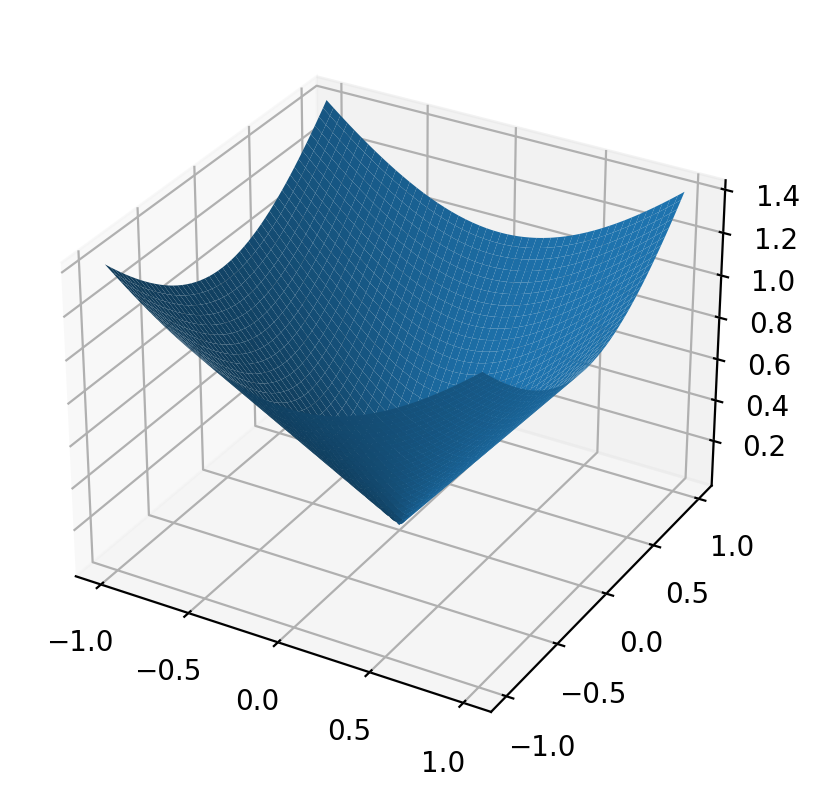

time taken:  19.12380051612854
neuron num 		 error 		 order
4 		 0.375468 		 * 		 

8 		 0.094690 		 1.987404 		 

16 		 0.025707 		 1.881057 		 

32 		 0.009554 		 1.427953 		 

64 		 0.003450 		 1.469651 		 

128 		 0.001445 		 1.255115 		 

256 		 0.000519 		 1.478892 		 

512 		 0.000221 		 1.228234 		 

1024 		 0.000085 		 1.373811 		 

neuron num  & 	 $\|u-u_n \|_{L^2}$ & 	 order \\ \hline \hline 
4 		 & 0.375468 &		 *  \\ \hline  

8 		 &  9.469e-02 &  		 1.99 \\ \hline  

16 		 &  2.571e-02 &  		 1.88 \\ \hline  

32 		 &  9.554e-03 &  		 1.43 \\ \hline  

64 		 &  3.450e-03 &  		 1.47 \\ \hline  

128 		 &  1.445e-03 &  		 1.26 \\ \hline  

256 		 &  5.185e-04 &  		 1.48 \\ \hline  

512 		 &  2.213e-04 &  		 1.23 \\ \hline  

1024 		 &  8.540e-05 &  		 1.37 \\ \hline  



In [12]:
def show_convergence_order(err_l2,exponent,dict_size, filename,write2file = False):
    
    if write2file:
        file_mode = "a" if os.path.exists(filename) else "w"
        f_write = open(filename, file_mode)
    
    neuron_nums = [2**j for j in range(2,exponent+1)]
    err_list = [err_l2[i] for i in neuron_nums ]

    # f_write.write('M:{}, relu {} \n'.format(M,k))
    if write2file:
        f_write.write('dictionary size: {}\n'.format(dict_size))
        f_write.write("neuron num \t\t error \t\t order \t\t h10 error \\ order \n")
    print("neuron num \t\t error \t\t order")
    for i, item in enumerate(err_list):
        if i == 0: 
            # print(neuron_nums[i], end = "\t\t")
            # print(item, end = "\t\t")
            
            # print("*")
            print("{} \t\t {:.6f} \t\t * \t\t \n".format(neuron_nums[i],item) )
            if write2file: 
                f_write.write("{} \t\t {} \t\t * \t\t \n".format(neuron_nums[i],item ))
        else:
            # print(neuron_nums[i], end = "\t\t")
            # print(item, end = "\t\t") 
            # print(np.log(err_list[i-1]/err_list[i])/np.log(2))
            print("{} \t\t {:.6f} \t\t {:.6f} \t\t \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2) ) )
            if write2file: 
                f_write.write("{} \t\t {} \t\t {}  \n".format(neuron_nums[i],item,np.log(err_list[i-1]/err_list[i])/np.log(2) ))
    if write2file:     
        f_write.write("\n")
        f_write.close()

def show_convergence_order_latex(err_l2,exponent): 
    neuron_nums = [2**j for j in range(2,exponent+1)]
    err_list = [err_l2[i] for i in neuron_nums ]
    print("neuron num  & \t $\|u-u_n \|_{L^2}$ & \t order \\\ \hline \hline ")
    for i, item in enumerate(err_list):
        if i == 0: 
            print("{} \t\t & {:.6f} &\t\t *  \\\ \hline  \n".format(neuron_nums[i],item, np.log(err_list[i-1]/err_list[i])/np.log(2) ) )   
        else: 
            print("{} \t\t &  {:.3e} &  \t\t {:.2f} \\\ \hline  \n".format(neuron_nums[i],item, np.log(err_list[i-1]/err_list[i])/np.log(2) ) )

# def target(x):
#     sigma = 0.15# s.d of Gaussian 
#     frequency = 4  # frequency of cosine 
#     z=  torch.exp( - ( (x[:,0:1]-0.5)**2 + ( x[:,1:2] -0.5)**2)  / (2*sigma**2)) *  torch.cos(2 * pi * frequency * x[:,0:1])
#     return z 

def target(x):
    """ Target function for the Poisson equation
    """
    return (x[:,0:1]**2 + x[:,1:2]**2)**0.5 


# function_name = "gabor2d" 
function_name = "cone2d" 
filename_write = "data_parameter_distribution_compare/2DQMCOGA-{}-order.txt".format(function_name)
f_write = open(filename_write, "a")
f_write.write("\n")
f_write.close() 

for N0 in [2**10]: 
    save = True
    f_write = open(filename_write, "a")
    my_model = None 
    s = 2**0
    Nx = 50 
    order = 3    
    exponent = 10  
    num_epochs = 2**exponent  
    plot_freq = num_epochs
    relu_k = 2 
    Domain = [[-1,-1],[1,1]] 
    err_QMC2, my_model = OGAL2FittingReLU2D_QMC(my_model,target,s,N0,num_epochs,plot_freq, Nx, order, k =relu_k, linear_solver = "direct",Domain = Domain)
    
    if save: 
        folder = 'data_parameter_distribution_compare/'
        filename = folder + 'err_OGA_2D_{}_relu{}_neuron_{}_N_{}_randomized.pt'.format(function_name,relu_k, num_epochs,s*N0)
        torch.save(err_QMC2,filename) 
        folder = 'data_parameter_distribution_compare/'
        filename = folder + 'model_OGA_2D_{}_relu{}_neuron_{}_N_{}_randomized.pt'.format(function_name,relu_k, num_epochs,s*N0)
        torch.save(my_model.state_dict(),filename)

    dict_size = s*N0 
    show_convergence_order(err_QMC2,exponent,dict_size, filename_write,write2file = True)
    show_convergence_order_latex(err_QMC2,exponent) 



using linear solver:  direct
epoch:  1	assembling the matrix time taken:  0.0002505779266357422
solving Ax = b time taken:  0.000255584716796875
epoch:  2	assembling the matrix time taken:  0.0002608299255371094
solving Ax = b time taken:  0.00017404556274414062
epoch:  3	assembling the matrix time taken:  0.00020956993103027344
solving Ax = b time taken:  0.00014352798461914062
epoch:  4	assembling the matrix time taken:  0.00023412704467773438
solving Ax = b time taken:  0.00015854835510253906
epoch:  5	assembling the matrix time taken:  0.00023889541625976562
solving Ax = b time taken:  0.00015687942504882812
epoch:  6	assembling the matrix time taken:  0.00020766258239746094
solving Ax = b time taken:  0.00015091896057128906
epoch:  7	assembling the matrix time taken:  0.00024771690368652344
solving Ax = b time taken:  0.00016570091247558594
epoch:  8	assembling the matrix time taken:  0.00020599365234375
solving Ax = b time taken:  0.00014328956604003906
epoch:  9	assembling the m

epoch:  80	assembling the matrix time taken:  0.0002655982971191406
solving Ax = b time taken:  0.0004899501800537109
epoch:  81	assembling the matrix time taken:  0.00024175643920898438
solving Ax = b time taken:  0.0005383491516113281
epoch:  82	assembling the matrix time taken:  0.000263214111328125
solving Ax = b time taken:  0.000522613525390625
epoch:  83	assembling the matrix time taken:  0.0002644062042236328
solving Ax = b time taken:  0.0005276203155517578
epoch:  84	assembling the matrix time taken:  0.0002903938293457031
solving Ax = b time taken:  0.0005269050598144531
epoch:  85	assembling the matrix time taken:  0.00033092498779296875
solving Ax = b time taken:  0.0005087852478027344
epoch:  86	assembling the matrix time taken:  0.0002758502960205078
solving Ax = b time taken:  0.0005369186401367188
epoch:  87	assembling the matrix time taken:  0.00026488304138183594
solving Ax = b time taken:  0.0005562305450439453
epoch:  88	assembling the matrix time taken:  0.0002622

solving Ax = b time taken:  0.0014481544494628906
epoch:  168	assembling the matrix time taken:  0.00029468536376953125
solving Ax = b time taken:  0.0013904571533203125
epoch:  169	assembling the matrix time taken:  0.0002770423889160156
solving Ax = b time taken:  0.001299142837524414
epoch:  170	assembling the matrix time taken:  0.0003070831298828125
solving Ax = b time taken:  0.0012581348419189453
epoch:  171	assembling the matrix time taken:  0.00028705596923828125
solving Ax = b time taken:  0.0012841224670410156
epoch:  172	assembling the matrix time taken:  0.00026869773864746094
solving Ax = b time taken:  0.0012836456298828125
epoch:  173	assembling the matrix time taken:  0.0002827644348144531
solving Ax = b time taken:  0.0013003349304199219
epoch:  174	assembling the matrix time taken:  0.0002684593200683594
solving Ax = b time taken:  0.0013134479522705078
epoch:  175	assembling the matrix time taken:  0.0002696514129638672
solving Ax = b time taken:  0.0013167858123779

solving Ax = b time taken:  0.0018439292907714844
epoch:  239	assembling the matrix time taken:  0.0003311634063720703
solving Ax = b time taken:  0.001867055892944336
epoch:  240	assembling the matrix time taken:  0.0003604888916015625
solving Ax = b time taken:  0.0018248558044433594
epoch:  241	assembling the matrix time taken:  0.00034046173095703125
solving Ax = b time taken:  0.0018947124481201172
epoch:  242	assembling the matrix time taken:  0.0003437995910644531
solving Ax = b time taken:  0.0018787384033203125
epoch:  243	assembling the matrix time taken:  0.0003376007080078125
solving Ax = b time taken:  0.0018985271453857422
epoch:  244	assembling the matrix time taken:  0.00034809112548828125
solving Ax = b time taken:  0.001875162124633789
epoch:  245	assembling the matrix time taken:  0.0003352165222167969
solving Ax = b time taken:  0.0019168853759765625
epoch:  246	assembling the matrix time taken:  0.00034809112548828125
solving Ax = b time taken:  0.00190544128417968

epoch:  315	assembling the matrix time taken:  0.00034737586975097656
solving Ax = b time taken:  0.0028133392333984375
epoch:  316	assembling the matrix time taken:  0.00031685829162597656
solving Ax = b time taken:  0.0028502941131591797
epoch:  317	assembling the matrix time taken:  0.0003228187561035156
solving Ax = b time taken:  0.0028777122497558594
epoch:  318	assembling the matrix time taken:  0.00030040740966796875
solving Ax = b time taken:  0.0028901100158691406
epoch:  319	assembling the matrix time taken:  0.0003223419189453125
solving Ax = b time taken:  0.0028853416442871094
epoch:  320	assembling the matrix time taken:  0.0003757476806640625
solving Ax = b time taken:  0.002830982208251953
epoch:  321	assembling the matrix time taken:  0.00033092498779296875
solving Ax = b time taken:  0.0031957626342773438
epoch:  322	assembling the matrix time taken:  0.00031757354736328125
solving Ax = b time taken:  0.003212451934814453
epoch:  323	assembling the matrix time taken:

epoch:  396	assembling the matrix time taken:  0.0003693103790283203
solving Ax = b time taken:  0.004068851470947266
epoch:  397	assembling the matrix time taken:  0.0003535747528076172
solving Ax = b time taken:  0.004173755645751953
epoch:  398	assembling the matrix time taken:  0.0003733634948730469
solving Ax = b time taken:  0.004136323928833008
epoch:  399	assembling the matrix time taken:  0.0004017353057861328
solving Ax = b time taken:  0.0041255950927734375
epoch:  400	assembling the matrix time taken:  0.0003390312194824219
solving Ax = b time taken:  0.004152059555053711
epoch:  401	assembling the matrix time taken:  0.0003190040588378906
solving Ax = b time taken:  0.004239797592163086
epoch:  402	assembling the matrix time taken:  0.00032138824462890625
solving Ax = b time taken:  0.004221916198730469
epoch:  403	assembling the matrix time taken:  0.0002892017364501953
solving Ax = b time taken:  0.0042819976806640625
epoch:  404	assembling the matrix time taken:  0.0002

epoch:  466	assembling the matrix time taken:  0.00031256675720214844
solving Ax = b time taken:  0.004891633987426758
epoch:  467	assembling the matrix time taken:  0.0002942085266113281
solving Ax = b time taken:  0.004895687103271484
epoch:  468	assembling the matrix time taken:  0.0002961158752441406
solving Ax = b time taken:  0.004891633987426758
epoch:  469	assembling the matrix time taken:  0.0002918243408203125
solving Ax = b time taken:  0.004964351654052734
epoch:  470	assembling the matrix time taken:  0.00029659271240234375
solving Ax = b time taken:  0.00491786003112793
epoch:  471	assembling the matrix time taken:  0.0003197193145751953
solving Ax = b time taken:  0.00491786003112793
epoch:  472	assembling the matrix time taken:  0.0002727508544921875
solving Ax = b time taken:  0.004918098449707031
epoch:  473	assembling the matrix time taken:  0.0002841949462890625
solving Ax = b time taken:  0.004967451095581055
epoch:  474	assembling the matrix time taken:  0.0003139

epoch:  540	assembling the matrix time taken:  0.00025963783264160156
solving Ax = b time taken:  0.006153106689453125
epoch:  541	assembling the matrix time taken:  0.00033283233642578125
solving Ax = b time taken:  0.006214618682861328
epoch:  542	assembling the matrix time taken:  0.0002808570861816406
solving Ax = b time taken:  0.006208896636962891
epoch:  543	assembling the matrix time taken:  0.00030112266540527344
solving Ax = b time taken:  0.00622248649597168
epoch:  544	assembling the matrix time taken:  0.0003101825714111328
solving Ax = b time taken:  0.006165742874145508
epoch:  545	assembling the matrix time taken:  0.00033736228942871094
solving Ax = b time taken:  0.006280422210693359
epoch:  546	assembling the matrix time taken:  0.00034427642822265625
solving Ax = b time taken:  0.0062541961669921875
epoch:  547	assembling the matrix time taken:  0.0003256797790527344
solving Ax = b time taken:  0.006287574768066406
epoch:  548	assembling the matrix time taken:  0.00

epoch:  616	assembling the matrix time taken:  0.0002493858337402344
solving Ax = b time taken:  0.007296562194824219
epoch:  617	assembling the matrix time taken:  0.0002467632293701172
solving Ax = b time taken:  0.007405996322631836
epoch:  618	assembling the matrix time taken:  0.00025653839111328125
solving Ax = b time taken:  0.007383584976196289
epoch:  619	assembling the matrix time taken:  0.0002865791320800781
solving Ax = b time taken:  0.007342100143432617
epoch:  620	assembling the matrix time taken:  0.00027632713317871094
solving Ax = b time taken:  0.0073010921478271484
epoch:  621	assembling the matrix time taken:  0.00026679039001464844
solving Ax = b time taken:  0.0073740482330322266
epoch:  622	assembling the matrix time taken:  0.0002722740173339844
solving Ax = b time taken:  0.007363080978393555
epoch:  623	assembling the matrix time taken:  0.0003075599670410156
solving Ax = b time taken:  0.007330894470214844
epoch:  624	assembling the matrix time taken:  0.00

epoch:  692	assembling the matrix time taken:  0.0002830028533935547
solving Ax = b time taken:  0.008935689926147461
epoch:  693	assembling the matrix time taken:  0.0002474784851074219
solving Ax = b time taken:  0.00911712646484375
epoch:  694	assembling the matrix time taken:  0.000278472900390625
solving Ax = b time taken:  0.009057998657226562
epoch:  695	assembling the matrix time taken:  0.0002751350402832031
solving Ax = b time taken:  0.00907135009765625
epoch:  696	assembling the matrix time taken:  0.0002689361572265625
solving Ax = b time taken:  0.00901174545288086
epoch:  697	assembling the matrix time taken:  0.0002739429473876953
solving Ax = b time taken:  0.00909280776977539
epoch:  698	assembling the matrix time taken:  0.0003094673156738281
solving Ax = b time taken:  0.009053230285644531
epoch:  699	assembling the matrix time taken:  0.0002808570861816406
solving Ax = b time taken:  0.009103775024414062
epoch:  700	assembling the matrix time taken:  0.000250101089

solving Ax = b time taken:  0.011314153671264648
epoch:  770	assembling the matrix time taken:  0.0002684593200683594
solving Ax = b time taken:  0.01093912124633789
epoch:  771	assembling the matrix time taken:  0.0002582073211669922
solving Ax = b time taken:  0.010974407196044922
epoch:  772	assembling the matrix time taken:  0.0002491474151611328
solving Ax = b time taken:  0.011311769485473633
epoch:  773	assembling the matrix time taken:  0.0003104209899902344
solving Ax = b time taken:  0.011389970779418945
epoch:  774	assembling the matrix time taken:  0.00034046173095703125
solving Ax = b time taken:  0.01117563247680664
epoch:  775	assembling the matrix time taken:  0.00038433074951171875
solving Ax = b time taken:  0.011179447174072266
epoch:  776	assembling the matrix time taken:  0.00035858154296875
solving Ax = b time taken:  0.011109590530395508
epoch:  777	assembling the matrix time taken:  0.0003795623779296875
solving Ax = b time taken:  0.011209249496459961
epoch:  7

epoch:  846	assembling the matrix time taken:  0.0003552436828613281
solving Ax = b time taken:  0.01214289665222168
epoch:  847	assembling the matrix time taken:  0.0003578662872314453
solving Ax = b time taken:  0.012140989303588867
epoch:  848	assembling the matrix time taken:  0.0003578662872314453
solving Ax = b time taken:  0.012084245681762695
epoch:  849	assembling the matrix time taken:  0.0003714561462402344
solving Ax = b time taken:  0.01224970817565918
epoch:  850	assembling the matrix time taken:  0.0003666877746582031
solving Ax = b time taken:  0.0122222900390625
epoch:  851	assembling the matrix time taken:  0.0003783702850341797
solving Ax = b time taken:  0.012244939804077148
epoch:  852	assembling the matrix time taken:  0.00029397010803222656
solving Ax = b time taken:  0.012217283248901367
epoch:  853	assembling the matrix time taken:  0.0002791881561279297
solving Ax = b time taken:  0.012296915054321289
epoch:  854	assembling the matrix time taken:  0.0002706050

epoch:  916	assembling the matrix time taken:  0.00037217140197753906
solving Ax = b time taken:  0.013783693313598633
epoch:  917	assembling the matrix time taken:  0.00038361549377441406
solving Ax = b time taken:  0.013976097106933594
epoch:  918	assembling the matrix time taken:  0.0003657341003417969
solving Ax = b time taken:  0.013984441757202148
epoch:  919	assembling the matrix time taken:  0.0003764629364013672
solving Ax = b time taken:  0.013947486877441406
epoch:  920	assembling the matrix time taken:  0.00033664703369140625
solving Ax = b time taken:  0.013950109481811523
epoch:  921	assembling the matrix time taken:  0.00037360191345214844
solving Ax = b time taken:  0.013973236083984375
epoch:  922	assembling the matrix time taken:  0.0003452301025390625
solving Ax = b time taken:  0.014006376266479492
epoch:  923	assembling the matrix time taken:  0.0003612041473388672
solving Ax = b time taken:  0.014026641845703125
epoch:  924	assembling the matrix time taken:  0.000

epoch:  987	assembling the matrix time taken:  0.0002815723419189453
solving Ax = b time taken:  0.015085458755493164
epoch:  988	assembling the matrix time taken:  0.00025725364685058594
solving Ax = b time taken:  0.015021085739135742
epoch:  989	assembling the matrix time taken:  0.00039124488830566406
solving Ax = b time taken:  0.015065670013427734
epoch:  990	assembling the matrix time taken:  0.0002701282501220703
solving Ax = b time taken:  0.015101194381713867
epoch:  991	assembling the matrix time taken:  0.00028634071350097656
solving Ax = b time taken:  0.015118122100830078
epoch:  992	assembling the matrix time taken:  0.0002944469451904297
solving Ax = b time taken:  0.014985084533691406
epoch:  993	assembling the matrix time taken:  0.0002613067626953125
solving Ax = b time taken:  0.015239238739013672
epoch:  994	assembling the matrix time taken:  0.00029540061950683594
solving Ax = b time taken:  0.015174150466918945
epoch:  995	assembling the matrix time taken:  0.000

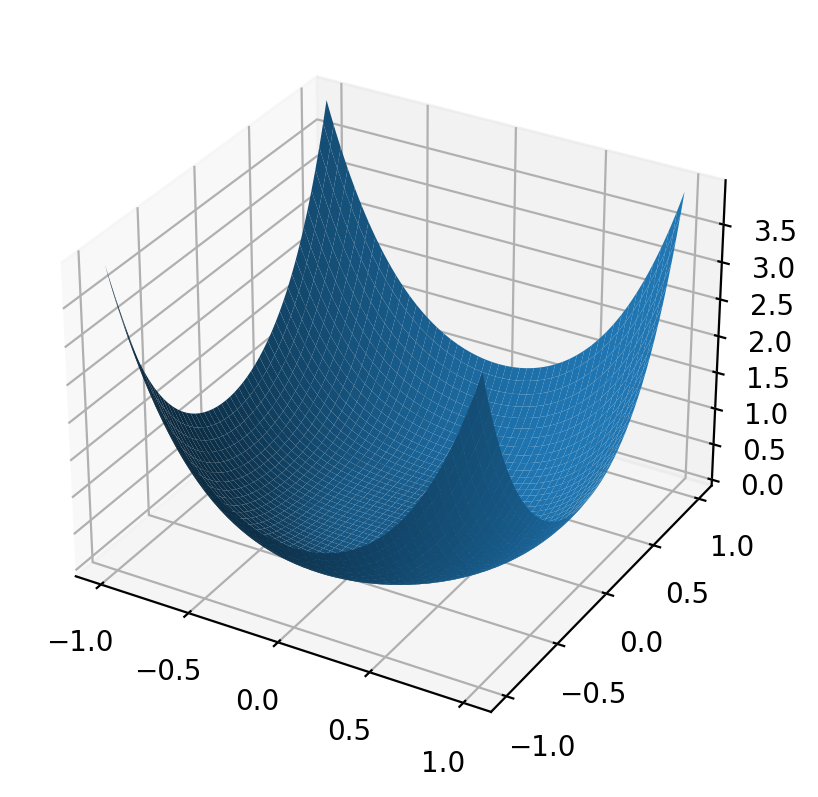

time taken:  19.441261053085327
neuron num 		 error 		 order
4 		 0.900519 		 * 		 

8 		 0.375637 		 1.261416 		 

16 		 0.127551 		 1.558267 		 

32 		 0.033282 		 1.938259 		 

64 		 0.010379 		 1.681098 		 

128 		 0.002330 		 2.155378 		 

256 		 0.000573 		 2.023672 		 

512 		 0.000156 		 1.875745 		 

1024 		 0.000042 		 1.878176 		 

neuron num  & 	 $\|u-u_n \|_{L^2}$ & 	 order \\ \hline \hline 
4 		 & 0.900519 &		 *  \\ \hline  

8 		 &  3.756e-01 &  		 1.26 \\ \hline  

16 		 &  1.276e-01 &  		 1.56 \\ \hline  

32 		 &  3.328e-02 &  		 1.94 \\ \hline  

64 		 &  1.038e-02 &  		 1.68 \\ \hline  

128 		 &  2.330e-03 &  		 2.16 \\ \hline  

256 		 &  5.730e-04 &  		 2.02 \\ \hline  

512 		 &  1.561e-04 &  		 1.88 \\ \hline  

1024 		 &  4.247e-05 &  		 1.88 \\ \hline  



In [15]:

#     sigma = 0.15# s.d of Gaussian 
#     frequency = 4  # frequency of cosine 
#     z=  torch.exp( - ( (x[:,0:1]-0.5)**2 + ( x[:,1:2] -0.5)**2)  / (2*sigma**2)) *  torch.cos(2 * pi * frequency * x[:,0:1])
#     return z 

def target(x):
    """ Target function for the Poisson equation
    """
    return (x[:,0:1]**2 + x[:,1:2]**2)**2  


# function_name = "gabor2d" 
function_name = "quartic2d" 
filename_write = "data_parameter_distribution_compare/2DQMCOGA-{}-order.txt".format(function_name)
f_write = open(filename_write, "a")
f_write.write("\n") 
f_write.close() 

for N0 in [2**10]: 
    save = True
    f_write = open(filename_write, "a")
    my_model = None 
    s = 2**0
    Nx = 50 
    order = 3    
    exponent = 10  
    num_epochs = 2**exponent  
    plot_freq = num_epochs
    relu_k = 2 
    Domain = [[-1,-1],[1,1]] 
    err_QMC2, my_model = OGAL2FittingReLU2D_QMC(my_model,target,s,N0,num_epochs,plot_freq, Nx, order, k =relu_k, linear_solver = "direct",Domain = Domain)
    
    if save: 
        folder = 'data_parameter_distribution_compare/'
        filename = folder + 'err_OGA_2D_{}_relu{}_neuron_{}_N_{}_randomized.pt'.format(function_name,relu_k, num_epochs,s*N0)
        torch.save(err_QMC2,filename) 
        folder = 'data_parameter_distribution_compare/'
        filename = folder + 'model_OGA_2D_{}_relu{}_neuron_{}_N_{}_randomized.pt'.format(function_name,relu_k, num_epochs,s*N0)
        torch.save(my_model.state_dict(),filename)

    dict_size = s*N0 
    show_convergence_order(err_QMC2,exponent,dict_size, filename_write,write2file = True)
    show_convergence_order_latex(err_QMC2,exponent) 



In [36]:
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio
from plotly.subplots import make_subplots

def plot_front_back_views_x_filtered(points, 
                                     point_color='red', 
                                     point_size=2.5, 
                                     sphere_opacity=0.3,
                                     north_pole_color='green',
                                     south_pole_color='blue',
                                     pole_size=10,
                                     pole_symbol='diamond',
                                     renderer='browser'):
    """
    Plots the scattered points on a unit sphere from two viewpoints based on the x-coordinate:
    - "Front" view: points with x > 0.
    - "Back" view: points with x ≤ 0.
    The sphere surface and pole markers are included in both views.
    
    Parameters:
    - points (array-like): An (N, 3) array of 3D coordinates.
    - point_color (str or array-like): Color of the scatter points.
    - point_size (int): Size of the scatter points.
    - sphere_opacity (float): Opacity of the unit sphere surface.
    - north_pole_color (str): Color for the North Pole marker.
    - south_pole_color (str): Color for the South Pole marker.
    - pole_size (int): Size of the pole markers.
    - pole_symbol (str): Marker symbol for the poles.
    - renderer (str): Plotly renderer type (e.g., 'browser', 'notebook').
    """
    
    # Set Plotly renderer
    pio.renderers.default = renderer

    # Ensure points is a NumPy array with shape (N,3)
    points = np.array(points)
    if points.shape[1] != 3:
        raise ValueError("`points` should be a (N, 3) array.")
    
    # Split points based on x-coordinate:
    front_points = points[points[:, 0] > 0]
    back_points  = points[points[:, 0] <= 0]

    # Generate coordinates for the unit sphere surface
    u = np.linspace(0, 2 * np.pi, 50)
    v = np.linspace(0, np.pi, 50)
    sphere_x = np.outer(np.cos(u), np.sin(v))
    sphere_y = np.outer(np.sin(u), np.sin(v))
    sphere_z = np.outer(np.ones_like(u), np.cos(v))

    # Create sphere surface trace
    sphere_surface = go.Surface(
        x=sphere_x,
        y=sphere_y,
        z=sphere_z,
        colorscale='Blues',
        opacity=sphere_opacity,
        showscale=False,
        name='Unit Sphere'
    )

    # Create scatter trace for front points (x > 0)
    scatter_front = go.Scatter3d(
        x=front_points[:, 0],
        y=front_points[:, 1],
        z=front_points[:, 2],
        mode='markers',
        marker=dict(
            size=point_size,
            color=point_color,
            opacity=0.8,
            line=dict(width=0.5, color='white')
        ),
        name='Front Points (x > 0)'
    )

    # Create scatter trace for back points (x <= 0)
    scatter_back = go.Scatter3d(
        x=back_points[:, 0],
        y=back_points[:, 1],
        z=back_points[:, 2],
        mode='markers',
        marker=dict(
            size=point_size,
            color=point_color,
            opacity=0.8,
            line=dict(width=0.5, color='white')
        ),
        name='Back Points (x ≤ 0)'
    )

    # Define North and South Pole markers (shown in both views)
    north_pole = go.Scatter3d(
        x=[0],
        y=[0],
        z=[1],
        mode='markers',
        marker=dict(
            size=pole_size,
            color=north_pole_color,
            symbol=pole_symbol,
            line=dict(width=1, color='black')
        ),
        name='North Pole'
    )

    south_pole = go.Scatter3d(
        x=[0],
        y=[0],
        z=[-1],
        mode='markers',
        marker=dict(
            size=pole_size,
            color=south_pole_color,
            symbol=pole_symbol,
            line=dict(width=1, color='black')
        ),
        name='South Pole'
    )

    # Create a subplot with 1 row and 2 columns for front/back views
    fig = make_subplots(
        rows=1, cols=2,
        specs=[[{'type': 'scene'}, {'type': 'scene'}]],
        subplot_titles=["Front View (x > 0)", "Back View (x ≤ 0)"],
        horizontal_spacing=0.02
    )

    # Add traces for the front view (only front_points)
    fig.add_trace(sphere_surface, row=1, col=1)
    fig.add_trace(scatter_front, row=1, col=1)
    fig.add_trace(north_pole, row=1, col=1)
    fig.add_trace(south_pole, row=1, col=1)

    # Add traces for the back view (only back_points)
    fig.add_trace(sphere_surface, row=1, col=2)
    fig.add_trace(scatter_back, row=1, col=2)
    fig.add_trace(north_pole, row=1, col=2)
    fig.add_trace(south_pole, row=1, col=2)

    # Define camera views:
    # Front view: camera looking from the positive x direction.
    front_camera = dict(eye=dict(x=2, y=0, z=0))
    # Back view: camera looking from the negative x direction.
    back_camera  = dict(eye=dict(x=-2, y=0, z=0))

    # Update layout for each scene
    fig.update_layout(
        scene=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            camera=front_camera,
            aspectmode='cube'
        ),
        scene2=dict(
            xaxis_title='X',
            yaxis_title='Y',
            zaxis_title='Z',
            camera=back_camera,
            aspectmode='cube'
        ),
        title_text='Front and Back Views of Points on a Sphere (Filtered by x-coordinate)',
        width=1200,
        height=600
    )

    fig.show()

# Example usage:
if __name__ == "__main__":
    # Generate some random points on the sphere surface
    np.random.seed(0)
    num_points = 500
    xyz = np.random.normal(size=(num_points, 3))
    norms = np.linalg.norm(xyz, axis=1, keepdims=True)
    xyz = xyz / norms  # normalize so points lie on the unit sphere

    plot_front_back_views_x_filtered(xyz,renderer='notebook')


In [26]:
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio

def plot_interactive_sphere(points, 
                            point_color='red', 
                            point_size=3, 
                            sphere_color='cyan', 
                            sphere_opacity=0.3,
                            north_pole_color='green',
                            south_pole_color='blue',
                            pole_size=10,
                            pole_symbol='diamond',
                            title='Interactive 3D Plot on Unit Sphere',
                            renderer='browser'):
    """
    Plots an interactive 3D scatter plot on a unit sphere, including the North and South Poles.

    Parameters:
    - points (array-like): An (N, 3) array of 3D coordinates.
    - point_color (str or array-like): Color of the scatter points. Default is 'red'.
    - point_size (int): Size of the scatter points. Default is 5.
    - sphere_color (str): Base color of the unit sphere. Default is 'cyan'.
    - sphere_opacity (float): Opacity of the sphere (0 to 1). Default is 0.3.
    - north_pole_color (str): Color of the North Pole marker. Default is 'green'.
    - south_pole_color (str): Color of the South Pole marker. Default is 'blue'.
    - pole_size (int): Size of the pole markers. Default is 10.
    - pole_symbol (str): Marker symbol for the poles. Default is 'diamond'.
    - title (str): Title of the plot. Default is 'Interactive 3D Plot on Unit Sphere'.
    - renderer (str): Plotly renderer type. Default is 'browser'.

    Returns:
    - None. Displays the interactive plot.
    """

    # Ensure points are a NumPy array
    points = np.array(points)
    if points.shape[1] != 3:
        raise ValueError("`points` should be a (N, 3) array.")

    # Set Plotly renderer
    pio.renderers.default = renderer

    # Create scatter plot for the main points
    scatter = go.Scatter3d(
        x=points[:, 0],
        y=points[:, 1],
        z=points[:, 2],
        mode='markers',
        marker=dict(
            size=point_size,
            color=point_color,
            opacity=0.8,
            line=dict(width=0.5, color='white')
        ),
        name='Scatter Points'
    )

    # Create unit sphere coordinates
    u = np.linspace(0, 2 * np.pi, 100)
    v = np.linspace(0, np.pi, 100)
    sphere_x = np.outer(np.cos(u), np.sin(v))
    sphere_y = np.outer(np.sin(u), np.sin(v))
    sphere_z = np.outer(np.ones_like(u), np.cos(v))

    # Create sphere surface
    sphere = go.Surface(
        x=sphere_x,
        y=sphere_y,
        z=sphere_z,
        colorscale='Blues',
        opacity=sphere_opacity,
        showscale=False,
        name='Unit Sphere'
    )

    # Define North Pole
    north_pole = go.Scatter3d(
        x=[0],
        y=[0],
        z=[1],
        mode='markers',
        marker=dict(
            size=pole_size,
            color=north_pole_color,
            opacity=1.0,
            symbol=pole_symbol,
            line=dict(width=1, color='black')
        ),
        name='North Pole'
    )

    # Define South Pole
    south_pole = go.Scatter3d(
        x=[0],
        y=[0],
        z=[-1],
        mode='markers',
        marker=dict(
            size=pole_size,
            color=south_pole_color,
            opacity=1.0,
            symbol=pole_symbol,
            line=dict(width=1, color='black')
        ),
        name='South Pole'
    )

    # Define layout
    layout = go.Layout(
        title=title,
        scene=dict(
            xaxis=dict(title='X-axis'),
            yaxis=dict(title='Y-axis'),
            zaxis=dict(title='Z-axis'),
            aspectmode='data'  # Ensures equal scaling
        ),
        width=800,
        height=700
    )

    # Create figure with all traces
    fig = go.Figure(data=[sphere, scatter, north_pole, south_pole], layout=layout)

    # Display the plot
    fig.show()


w = my_model.fc1.weight.data 
b = my_model.fc1.bias.data 
w_b = torch.cat((w,b.reshape(-1,1)),1) 
# Normalize the weights along dimension 1
# w_b_normalized = w_b / torch.norm(w_b, dim=1, keepdim=True)
# plot_interactive_sphere(w_b,point_size=3,title = "Grid selected by OGA", renderer='notebook') 
# plot_interactive_sphere(w_b_normalized,point_size=3,title = "Grid selected by OGA", renderer='notebook')

plot_front_back_views_x_filtered(w_b,renderer='notebook')

In [39]:
w_b_half = torch.load('one-cosine-pi.pt',map_location=torch.device('cpu'))
plot_front_back_views_x_filtered(w_b_half,renderer='notebook')

In [84]:
import torch
import numpy as np
import plotly.graph_objs as go
import plotly.io as pio

# Set default renderer (optional)
# You can change 'browser', 'notebook', etc., depending on your environment
pio.renderers.default = 'notebook'  # Opens in the default web browser

# Assuming my_model is already defined and loaded
# Uncomment the following line if you need to visualize 2D data
# plot_2D(my_model.cpu())

# Extract weights and biases from the first fully connected layer
w = my_model.fc1.weight.data 
b = my_model.fc1.bias.data 
w_b = torch.cat((w, b.reshape(-1, 1)), 1) 

# Normalize the weights along dimension 1
w_b_normalized = w_b / torch.norm(w_b, dim=1, keepdim=True)

# Parameters for plotting
neuron_num = 200  # Number of neurons to plot (adjust as needed)

# Extract coordinates
x_coords = w_b_normalized[:neuron_num, 0].numpy()
y_coords = w_b_normalized[:neuron_num, 1].numpy()
z_coords = w_b_normalized[:neuron_num, 2].numpy()

# Create scatter plot for normalized weights
scatter = go.Scatter3d(
    x=x_coords,
    y=y_coords,
    z=z_coords,
    mode='markers',
    marker=dict(
        size=5,
        color='red',
        opacity=0.8,
        line=dict(width=0.5, color='white')
    ),
    name='Normalized Weights'
)

# Create the unit sphere
u = np.linspace(0, 2 * np.pi, 100)
v = np.linspace(0, np.pi, 100)
sphere_x = np.outer(np.cos(u), np.sin(v))
sphere_y = np.outer(np.sin(u), np.sin(v))
sphere_z = np.outer(np.ones(np.size(u)), np.cos(v))

# Create mesh for the sphere
sphere = go.Surface(
    x=sphere_x,
    y=sphere_y,
    z=sphere_z,
    colorscale='Blues',
    opacity=0.3,
    showscale=False,
    name='Unit Sphere'
)

# Define the layout
layout = go.Layout(
    title='Interactive 3D Plot of Normalized Weights on a Unit Sphere',
    scene=dict(
        xaxis=dict(title='X-axis'),
        yaxis=dict(title='Y-axis'),
        zaxis=dict(title='Z-axis'),
        aspectmode='data'  # Ensures equal scaling for all axes
    ),
    legend=dict(
        itemsizing='constant'
    ),
    width=800,
    height=700
)

# Combine the scatter and sphere
fig = go.Figure(data=[sphere, scatter], layout=layout)

# Add legend manually since Plotly doesn't handle legends for surfaces by default
fig.update_layout(
    showlegend=True,
    legend=dict(
        x=0.8,
        y=0.95,
        bgcolor='rgba(255,255,255,0.5)',
        bordercolor='Black',
        borderwidth=1
    )
)

# To add custom legend entries, use annotations or other workarounds
# However, for simplicity, we'll rely on hover information

# Display the plot
fig.show()


## Random feature method - 1 
- $(\omega, b) \in S^{1} \times [-\sqrt{2},\sqrt{2}]$


## Random feature method - 2 

- $(\omega, b) \in S^{2}$
- $\Omega = [0,1]^2$

In [88]:
points = torch.randn(100,3)
points = points/torch.norm(points, dim=1, keepdim=True)

plot_interactive_sphere(points,renderer='notebook')


In [109]:
# generate uniform points on the sphere 
neuron_nums = 1000 
indices = torch.arange(0, neuron_nums, dtype=torch.float) + 0.5
phi = torch.acos(1 - 2*indices/neuron_nums)
theta = pi * (1 + 5**0.5) * indices
x = torch.sin(phi) * torch.cos(theta)
y = torch.sin(phi) * torch.sin(theta)
z = torch.cos(phi)
points = torch.stack((x, y, z), dim=1) 
plot_interactive_sphere(points,renderer='notebook')




In [116]:
def generate_fibonacci_sphere_numpy(num_points):
    """
    Generates points uniformly distributed on a unit sphere using the Fibonacci lattice method.

    Parameters:
    - num_points (int): Number of points to generate.

    Returns:
    - points (np.ndarray): An (N, 3) array of 3D coordinates on the unit sphere.
    """
    indices = np.arange(0, num_points) + 0.5

    # Golden angle in radians
    golden_angle = np.pi * (3 - np.sqrt(5)) # np.pi * (1 + 5**0.5)  # 
    phi = np.arccos(1 - 2 * indices / num_points)  # Polar angle

    theta = golden_angle * indices  # Azimuthal angle

    x = np.sin(phi) * np.cos(theta)
    y = np.sin(phi) * np.sin(theta)
    z = np.cos(phi)

    points = np.stack((x, y, z), axis=1)
    return points

points = generate_fibonacci_sphere_numpy(1000)
plot_interactive_sphere(points,renderer='notebook') 

In [51]:
def generate_relu_dict2D_QMC(s,N0):

    samples = torch.rand(s*N0,2) 
    
    T =torch.tensor([[2*pi,0],[0,2.84]])

    shift = torch.tensor([0,-1.42]) 

    samples = samples@T + shift 

    theta = samples[:,0].reshape(s*N0,1)
    W1 = torch.cos(theta)
    W2 = torch.sin(theta)
    W = torch.cat((W1,W2),1) # N1 x 2
    # b = np.linspace(-1.42, 1.42, N2,endpoint=False).reshape(N2,1) 
    b = samples[:,1].reshape(s*N0,1)
    
    Wb = torch.cat((W,b),1) # N1 x 3 

def initialize_model_1(my_model):
    # w ~ U(S^1), b ~ U(-1.42,1.42), random 
    neuron_nums = my_model.fc1.bias.size(0)
    samples = torch.rand(neuron_nums,2) 
    T =torch.tensor([[2*pi,0],[0,2.84]])
    shift = torch.tensor([0,-1.42]) 
    samples = samples@T + shift 
    theta = samples[:,0].reshape(neuron_nums,1)
    W1 = torch.cos(theta)
    W2 = torch.sin(theta)
    W = torch.cat((W1,W2),1) # N1 x 2
    b = samples[:,1].reshape(neuron_nums,1)
    my_model.fc1.weight.data[:,:] = W[:,:] 
    my_model.fc1.bias.data[:] = b[:,0] 
    
    return my_model 

def initialize_model_2(my_model):
    # (w,b) ~ U(S^2) random 
    neuron_nums = my_model.fc1.bias.size(0)
    points = torch.randn(neuron_nums,3)
    points = points/torch.norm(points, dim=1, keepdim=True)
    my_model.fc1.weight.data[:,:] = points[:,0:2]
    my_model.fc1.bias.data[:] = points[:,2]  
    return my_model 

def initialize_model_3(my_model):
    # generate a uniform grid on S^2 
    neuron_nums = my_model.fc1.bias.size(0) 

    indices = torch.arange(0, neuron_nums, dtype=torch.float) + 0.5
    phi = torch.acos(1 - 2*indices/neuron_nums)
    theta = pi * (1 + 5**0.5) * indices
    x = torch.sin(phi) * torch.cos(theta)
    y = torch.sin(phi) * torch.sin(theta)
    z = torch.cos(phi)

    points = torch.stack((x, y, z), dim=1)
    my_model.fc1.weight.data[:,:] = points[:,0:2]
    my_model.fc1.bias.data[:] = points[:,2]
    return my_model 
    
# def target(x):
#     sigma = 0.15# s.d of Gaussian 
#     frequency = 4  # frequency of cosine 
#     z=  torch.exp( - ( (x[:,0:1]-0.5)**2 + ( x[:,1:2] -0.5)**2)  / (2*sigma**2)) *  torch.cos(2 * pi * frequency * x[:,0:1])
#     return z 

def target(x): 
    return torch.cos(2*pi*x[:,0:1]) * torch.cos(2*pi*x[:,1:2])
integration_weights, integration_points = PiecewiseGQ2D_weights_points(100,3)
err_list = [] 
neuron_nums =  [2**j for j in range(2,10)] 
for neuron_num in neuron_nums: 
    my_model_rfm2 = model(2,neuron_num,1,1).to(device) 
    my_model_rfm2 = initialize_model_1(my_model_rfm2) 
    my_model_rfm2 = adjust_neuron_position(my_model_rfm2,2) 
    sol = minimize_linear_layer_explicit_assemble(my_model_rfm2,target,integration_weights, integration_points, "direct")
    my_model_rfm2.fc2.weight.data[0,:] = sol[:] 
    # plot_2D(my_model_rfm2) 
    err_l2 = (integration_weights.t()@(target(integration_points) - my_model_rfm2(integration_points).detach())**2)**0.5 
    print("L2 error: ",err_l2) 
    err_list.append(err_l2) 

# show convergence order 
err_list = [err.item() for err in err_list] 
print("neuron num  & \t $\|u-u_n \|_{L^2}$ & \t order \\\ \hline \hline ")
for i, item in enumerate(err_list):
    if i == 0: 
        print("{} \t\t & {:.6f} &\t\t *  \\\ \hline  \n".format(neuron_nums[i],item, np.log(err_list[i-1]/err_list[i])/np.log(2) ) )   
    else: 
        print("{} \t\t &  {:.3e} &  \t\t {:.2f} \\\ \hline  \n".format(neuron_nums[i],item, np.log(err_list[i-1]/err_list[i])/np.log(2) ) )


assembling the matrix time taken:  0.019493818283081055
solving Ax = b time taken:  0.0031328201293945312
L2 error:  tensor([[0.4997]])
assembling the matrix time taken:  0.02038121223449707
solving Ax = b time taken:  0.0009829998016357422
L2 error:  tensor([[0.4108]])
assembling the matrix time taken:  0.02538013458251953
solving Ax = b time taken:  0.0002219676971435547
L2 error:  tensor([[0.3407]])
assembling the matrix time taken:  0.042912960052490234
solving Ax = b time taken:  0.00026488304138183594
L2 error:  tensor([[0.2195]])
assembling the matrix time taken:  0.06966018676757812
solving Ax = b time taken:  0.00023293495178222656
L2 error:  tensor([[0.0800]])
assembling the matrix time taken:  0.14109086990356445
solving Ax = b time taken:  0.00040602684020996094
L2 error:  tensor([[0.0396]])
assembling the matrix time taken:  0.4164009094238281
solving Ax = b time taken:  0.001956939697265625
L2 error:  tensor([[0.0152]])
assembling the matrix time taken:  0.773117065429687

## Deterministic feature method - 3 

- $(\omega, b) \in S^{2}$
- $\Omega = [-1,1]^2$
- Remove Redundant features



In [95]:
def remove_redundant_neuron(my_model, dims = 3, choice = 1): 
    ##  choice 1:  [0,1]^d, choice 2: [-1,1]^d
    def create_mesh_grid(dims, pts):
        mesh = torch.tensor(list(itertools.product(pts,repeat=dims)))
        vertices = mesh.reshape(len(pts) ** dims, -1) 
        return vertices
    counter = 0 
    # positions = torch.tensor([[0.,0.],[0.,1.],[1.,1.],[1.,0.]])
    # pts = torch.tensor([0.,1.]) # for domain [0,1]^d 
    if choice == 1: 
        pts = torch.tensor([0.,1.])
    elif choice == 2:
        pts = torch.tensor([-1.,1.])# for domain [-1,1]^d 
    elif choice == 3:
        pts = torch.tensor([-1./2,1./2])# for domain [-1,1]^d 
    positions = create_mesh_grid(dims,pts) 
    neuron_num = my_model.fc1.bias.size(0)
    relu_k = my_model.k 
    recorded_neurons = []
    for i in range(neuron_num): 
        w = my_model.fc1.weight.data[i:i+1,:]
        b = my_model.fc1.bias.data[i]
        values = torch.matmul(positions,w.T)
        left_end = - torch.max(values)
        right_end = - torch.min(values)
        offset = (right_end - left_end)/50
        if b > left_end + offset/2 and b < right_end - offset/2: 
            recorded_neurons.append((w, b))
        elif b >= right_end - offset/2 and counter < (dims+1):
            recorded_neurons.append((w, b))
            counter += 1

    new_neuron_num = len(recorded_neurons)
    new_model = model(2, new_neuron_num, 1, k=relu_k).to(device)
    for i, (w, b) in enumerate(recorded_neurons):
        new_model.fc1.weight.data[i:i+1,:] = w
        new_model.fc1.bias.data[i] = b
    print("Number of neurons removed: ", neuron_num - new_neuron_num)
    print("Number of neurons left: ", new_neuron_num)  
    return new_model

In [140]:
def initialize_model_3(my_model):
    # generate a uniform grid on S^2 
    neuron_nums = my_model.fc1.bias.size(0) 

    indices = torch.arange(0, neuron_nums, dtype=torch.float) + 0.5
    phi = torch.acos(1 - 2*indices/neuron_nums)
    theta = pi * (1 + 5**0.5) * indices
    x = torch.sin(phi) * torch.cos(theta) 
    y = torch.sin(phi) * torch.sin(theta)  
    z = torch.cos(phi) 

    points = torch.stack((x, y, z), dim=1)
    my_model.fc1.weight.data[:,:] = points[:,0:2]
    my_model.fc1.bias.data[:] = points[:,2]
    return my_model 

def target(x):
    sigma = 0.15# s.d of Gaussian 
    frequency = 4  # frequency of cosine 
    z=  torch.exp( - ( (x[:,0:1]-0.5)**2 + ( x[:,1:2] -0.5)**2)  / (2*sigma**2)) *  torch.cos(2 * pi * frequency * x[:,0:1])
    return z 


# def target(x):
#     # sigma = 0.15# s.d of Gaussian 
#     # frequency = 4  # frequency of cosine 
#     # z=  torch.exp( - ( (x[:,0:1]-0.5)**2 + ( x[:,1:2] -0.5)**2)  / (2*sigma**2)) *  torch.cos(2 * pi * frequency * x[:,0:1])

#     return torch.cos(pi*x[:,0:1]) * torch.cos(pi*x[:,1:2]) 

integration_weights, integration_points = PiecewiseGQ2D_weights_points_general_square(100,3,bl = [-1/2,-1/2],ur = [1/2,1/2])
err_list = [] 
actual_neuron_list = [] 
# neuron_nums =  [2**j for j in range(2,12)] 
neuron_nums =  [100,200,400,800] 

relu_k = 2 
for neuron_num in neuron_nums: 
    my_model_rfm2 = model(2,neuron_num,1,k = relu_k).to(device) 
    my_model_rfm2 = initialize_model_3(my_model_rfm2) 
    # my_model_rfm2 = adjust_neuron_position(my_model_rfm2,2) 
    my_model_rfm2 = remove_redundant_neuron(my_model_rfm2,2,choice=3)
    sol = minimize_linear_layer_explicit_assemble(my_model_rfm2,target,integration_weights, integration_points, "direct")
    my_model_rfm2.fc2.weight.data[0,:] = sol[:] 
    # plot_2D(my_model_rfm2) 
    err_l2 = (integration_weights.t()@(target(integration_points) - my_model_rfm2(integration_points).detach())**2)**0.5 
    print("L2 error: ",err_l2) 
    err_list.append(err_l2) 
    actual_neuron_list.append(my_model_rfm2.fc1.bias.size(0)) 

# show convergence order 
err_list = [err.item() for err in err_list] 
print("neuron num  & \t $\|u-u_n \|_{L^2}$ & \t order \\\ \hline \hline ")
for i, item in enumerate(err_list):
    if i == 0: 
        print("{} \t\t & {:.6f} &\t\t *  \\\ \hline  \n".format(actual_neuron_list[i],item, np.log(err_list[i-1]/err_list[i])/np.log(actual_neuron_list[i]/actual_neuron_list[i-1]) ) )   
    else: 
        print("{} \t\t &  {:.3e} &  \t\t {:.2f} \\\ \hline  \n".format(actual_neuron_list[i],item, np.log(err_list[i-1]/err_list[i])/np.log(actual_neuron_list[i]/actual_neuron_list[i-1]) ) )


Number of neurons removed:  45
Number of neurons left:  55
assembling the matrix time taken:  0.07214999198913574
solving Ax = b time taken:  0.00036025047302246094
L2 error:  tensor([[0.0507]])
Number of neurons removed:  90
Number of neurons left:  110
assembling the matrix time taken:  0.16471505165100098
solving Ax = b time taken:  0.00038313865661621094
L2 error:  tensor([[0.0281]])
Number of neurons removed:  188
Number of neurons left:  212
assembling the matrix time taken:  0.37800121307373047
solving Ax = b time taken:  0.0011789798736572266
L2 error:  tensor([[0.0138]])
Number of neurons removed:  377
Number of neurons left:  423
assembling the matrix time taken:  0.6421041488647461
solving Ax = b time taken:  0.005645036697387695
L2 error:  tensor([[0.0047]])
neuron num  & 	 $\|u-u_n \|_{L^2}$ & 	 order \\ \hline \hline 
55 		 & 0.050693 &		 *  \\ \hline  

110 		 &  2.806e-02 &  		 0.85 \\ \hline  

212 		 &  1.376e-02 &  		 1.09 \\ \hline  

423 		 &  4.727e-03 &  		 1.55 

In [134]:
my_model_rfm2

model(
  (fc1): Linear(in_features=2, out_features=897, bias=True)
  (fc2): Linear(in_features=897, out_features=1, bias=False)
)

In [163]:
w = my_model_rfm2.fc1.weight.data 
b = my_model_rfm2.fc1.bias.data 
w_b = torch.cat((w,b.reshape(-1,1)),1) 
# Normalize the weights along dimension 1
w_b_normalized = w_b / torch.norm(w_b, dim=1, keepdim=True)

plot_interactive_sphere(w_b_normalized, point_size=3, title = "Deterministic Uniform grid on a sphere", renderer='notebook') 